# Siren Exploration

This is a colab to explore properties of the Siren MLP, proposed in our work [Implicit Neural Activations with Periodic Activation Functions](https://vsitzmann.github.io/siren).


We will first implement a streamlined version of Siren for fast experimentation. This lacks the code to easily do baseline comparisons - please refer to the main code for that - but will greatly simplify the code!

**Make sure that you have enabled the GPU under Edit -> Notebook Settings!**

We will then reproduce the following results from the paper: 
* [Fitting an image](#section_1)
* [Fitting an audio signal](#section_2)
* [Solving Poisson's equation](#section_3)
* [Initialization scheme & distribution of activations](#activations)
* [Distribution of activations is shift-invariant](#shift_invariance)

We will also explore Siren's [behavior outside of the training range](#out_of_range).

Let's go! First, some imports, and a function to quickly generate coordinate grids.

In [1]:
! nvidia-smi

Wed Apr 26 12:24:50 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P8    14W /  70W |      2MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla T4            Off  | 00000000:00:05.0 Off |                    0 |
| N/A   

In [2]:
device = 'cuda:0'

In [3]:
import torch
from torch import nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import os

from PIL import Image
from torchvision.transforms import Resize, Compose, ToTensor, Normalize
import numpy as np
import skimage
import matplotlib.pyplot as plt

import time

def get_mgrid(sidelen, dim=2):
    '''Generates a flattened grid of (x,y,...) coordinates in a range of -1 to 1.
    sidelen: int
    dim: int'''
    tensors = tuple(dim * [torch.linspace(-1, 1, steps=sidelen)])
    mgrid = torch.stack(torch.meshgrid(*tensors), dim=-1)
    mgrid = mgrid.reshape(-1, dim)
    return mgrid

Now, we code up the sine layer, which will be the basic building block of SIREN. This is a much more concise implementation than the one in the main code, as here, we aren't concerned with the baseline comparisons.

In [4]:
class SineLayer(nn.Module):
    # See paper sec. 3.2, final paragraph, and supplement Sec. 1.5 for discussion of omega_0.
    
    # If is_first=True, omega_0 is a frequency factor which simply multiplies the activations before the 
    # nonlinearity. Different signals may require different omega_0 in the first layer - this is a 
    # hyperparameter.
    
    # If is_first=False, then the weights will be divided by omega_0 so as to keep the magnitude of 
    # activations constant, but boost gradients to the weight matrix (see supplement Sec. 1.5)
    
    def __init__(self, in_features, out_features, bias=True,
                 is_first=False, omega_0=30):
        super().__init__()
        self.omega_0 = omega_0
        self.is_first = is_first
        
        self.in_features = in_features
        self.linear = nn.Linear(in_features, out_features, bias=bias)
        
        self.init_weights()
    
    def init_weights(self):
        with torch.no_grad():
            if self.is_first:
                self.linear.weight.uniform_(-1 / self.in_features, 
                                             1 / self.in_features)      
            else:
                self.linear.weight.uniform_(-np.sqrt(6 / self.in_features) / self.omega_0, 
                                             np.sqrt(6 / self.in_features) / self.omega_0)
        
    def forward(self, input):
        return torch.sin(self.omega_0 * self.linear(input))
    
    def forward_with_intermediate(self, input): 
        # For visualization of activation distributions
        intermediate = self.omega_0 * self.linear(input)
        return torch.sin(intermediate), intermediate
    
    
class Siren(nn.Module):
    def __init__(self, in_features, hidden_features, hidden_layers, out_features, outermost_linear=False, 
                 first_omega_0=30, hidden_omega_0=30.):
        super().__init__()
        
        self.net = []
        self.net.append(SineLayer(in_features, hidden_features, 
                                  is_first=True, omega_0=first_omega_0))

        for i in range(hidden_layers):
            self.net.append(SineLayer(hidden_features, hidden_features, 
                                      is_first=False, omega_0=hidden_omega_0))

        if outermost_linear:
            final_linear = nn.Linear(hidden_features, out_features)
            
            with torch.no_grad():
                final_linear.weight.uniform_(-np.sqrt(6 / hidden_features) / hidden_omega_0, 
                                              np.sqrt(6 / hidden_features) / hidden_omega_0)
                
            self.net.append(final_linear)
        else:
            self.net.append(SineLayer(hidden_features, out_features, 
                                      is_first=False, omega_0=hidden_omega_0))
        
        self.net = nn.Sequential(*self.net)
    
    def forward(self, coords):
        coords = coords.clone().detach().requires_grad_(True) # allows to take derivative w.r.t. input
        output = self.net(coords)
        return output, coords        

    def forward_with_activations(self, coords, retain_grad=False):
        '''Returns not only model output, but also intermediate activations.
        Only used for visualizing activations later!'''
        activations = OrderedDict()

        activation_count = 0
        x = coords.clone().detach().requires_grad_(True)
        activations['input'] = x
        for i, layer in enumerate(self.net):
            if isinstance(layer, SineLayer):
                x, intermed = layer.forward_with_intermediate(x)
                
                if retain_grad:
                    x.retain_grad()
                    intermed.retain_grad()
                    
                activations['_'.join((str(layer.__class__), "%d" % activation_count))] = intermed
                activation_count += 1
            else: 
                x = layer(x)
                
                if retain_grad:
                    x.retain_grad()
                    
            activations['_'.join((str(layer.__class__), "%d" % activation_count))] = x
            activation_count += 1

        return activations

And finally, differential operators that allow us to leverage autograd to compute gradients, the laplacian, etc.

In [5]:
def laplace(y, x):
    grad = gradient(y, x)
    return divergence(grad, x)


def divergence(y, x):
    div = 0.
    for i in range(y.shape[-1]):
        div += torch.autograd.grad(y[..., i], x, torch.ones_like(y[..., i]), create_graph=True)[0][..., i:i+1]
    return div


def gradient(y, x, grad_outputs=None):
    if grad_outputs is None:
        grad_outputs = torch.ones_like(y)
    grad = torch.autograd.grad(y, [x], grad_outputs=grad_outputs, create_graph=True)[0]
    return grad

# Experiments

For the image fitting and poisson experiments, we'll use the classic cameraman image.

In [6]:
def get_cameraman_tensor(sidelength):
    img = Image.fromarray(skimage.data.camera())        
    transform = Compose([
        Resize(sidelength),
        ToTensor(),
        Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))
    ])
    img = transform(img)
    return img

<a id='section_1'></a>
## Fitting an image

First, let's simply fit that image!

We seek to parameterize a greyscale image $f(x)$ with pixel coordinates $x$ with a SIREN $\Phi(x)$.

That is we seek the function $\Phi$ such that:
$\mathcal{L}=\int_{\Omega} \lVert \Phi(\mathbf{x}) - f(\mathbf{x}) \rVert\mathrm{d}\mathbf{x}$
 is minimized, in which $\Omega$ is the domain of the image. 
 
We write a little datast that does nothing except calculating per-pixel coordinates:

In [7]:
class ImageFitting(Dataset):
    def __init__(self, sidelength):
        super().__init__()
        img = get_cameraman_tensor(sidelength)
        self.pixels = img.permute(1, 2, 0).view(-1, 1)
        self.coords = get_mgrid(sidelength, 2)

    def __len__(self):
        return 1

    def __getitem__(self, idx):    
        if idx > 0: raise IndexError
            
        return self.coords, self.pixels

Let's instantiate the dataset and our Siren. As pixel coordinates are 2D, the siren has 2 input features, and since the image is grayscale, it has one output channel.

In [8]:
cameraman = ImageFitting(256)
dataloader = DataLoader(cameraman, batch_size=1, pin_memory=True, num_workers=0)

img_siren = Siren(in_features=2, out_features=1, hidden_features=256, 
                  hidden_layers=3, outermost_linear=True)
img_siren.to(device)

/opt/conda/lib/python3.7/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=2, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (3): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (4): Linear(in_features=256, out_features=1, bias=True)
  )
)

We now fit Siren in a simple training loop. Within only hundreds of iterations, the image and its gradients are approximated well.

Step 0, Total loss 0.325889


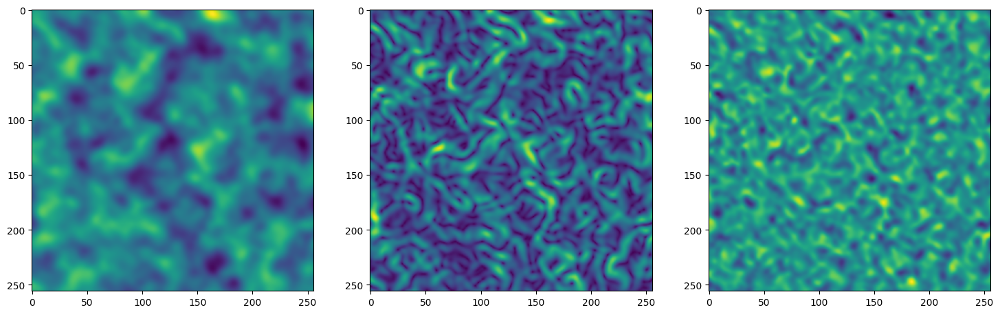

Step 10, Total loss 0.043179


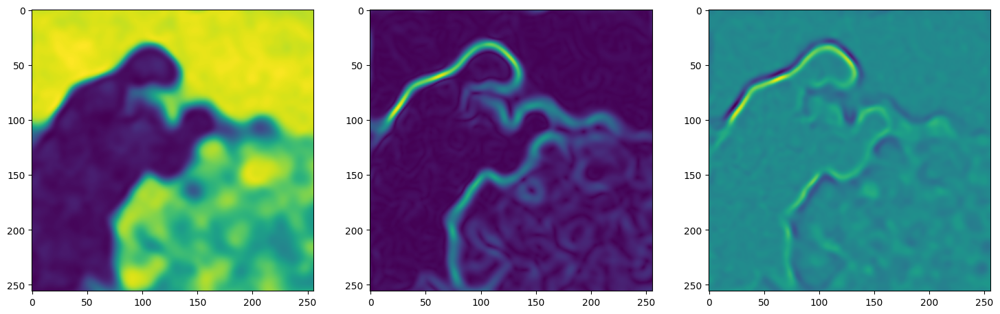

Step 20, Total loss 0.021617


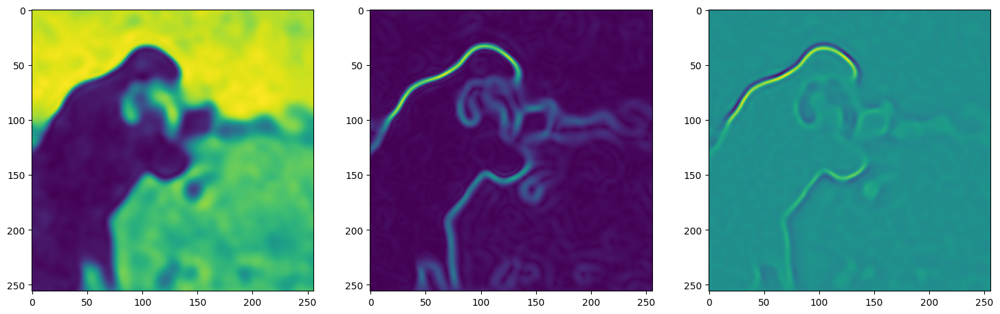

Step 30, Total loss 0.016194


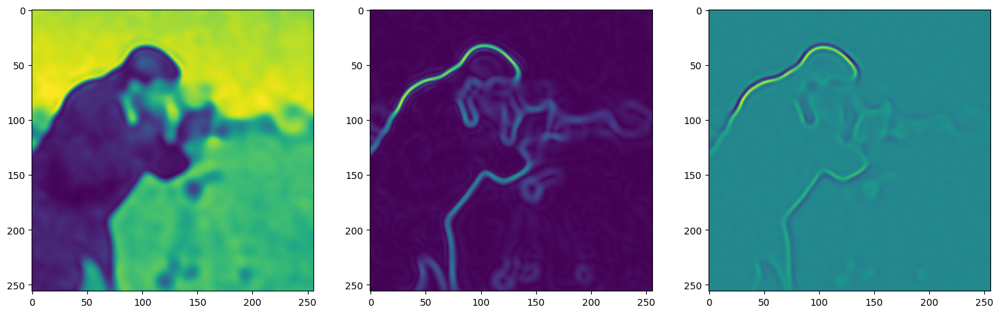

Step 40, Total loss 0.013538


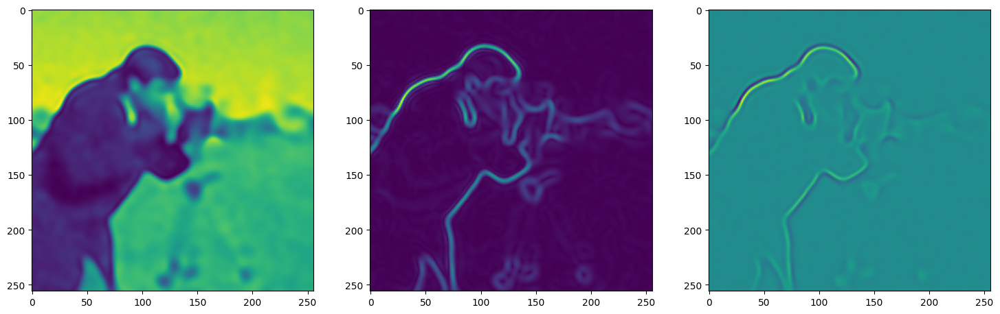

Step 50, Total loss 0.011957


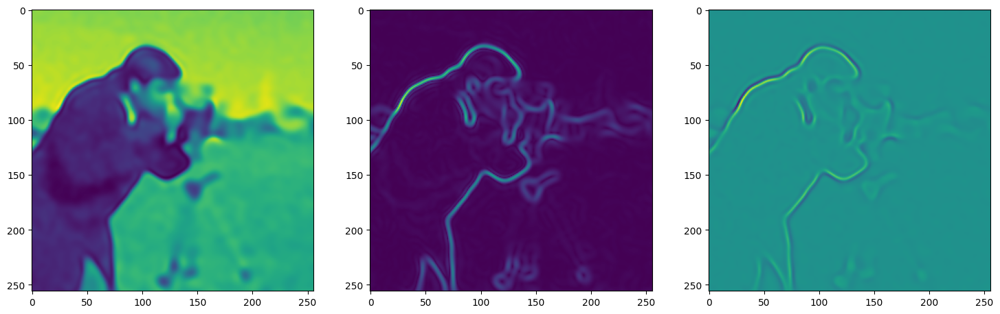

Step 60, Total loss 0.010837


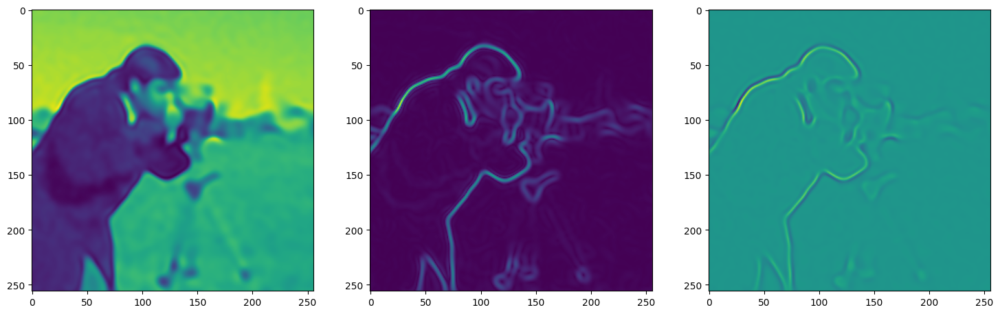

Step 70, Total loss 0.009972


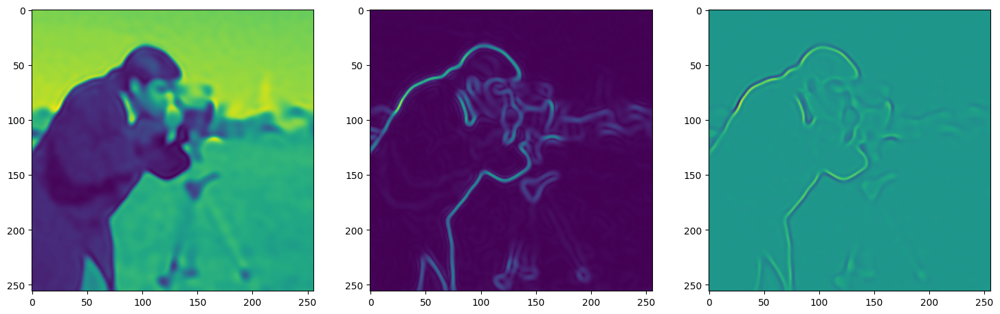

Step 80, Total loss 0.009245


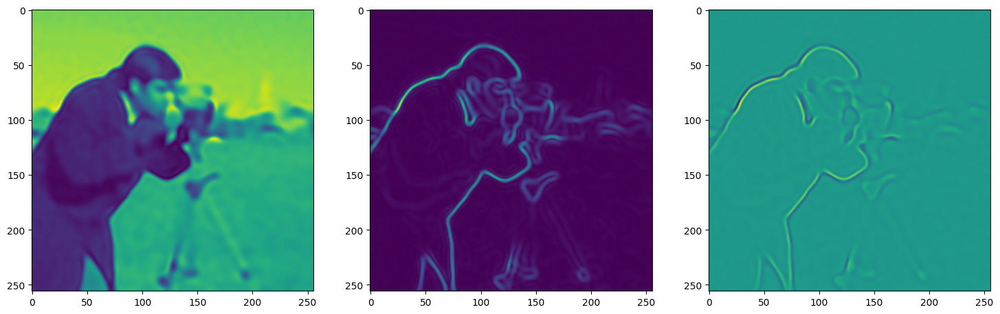

Step 90, Total loss 0.008611


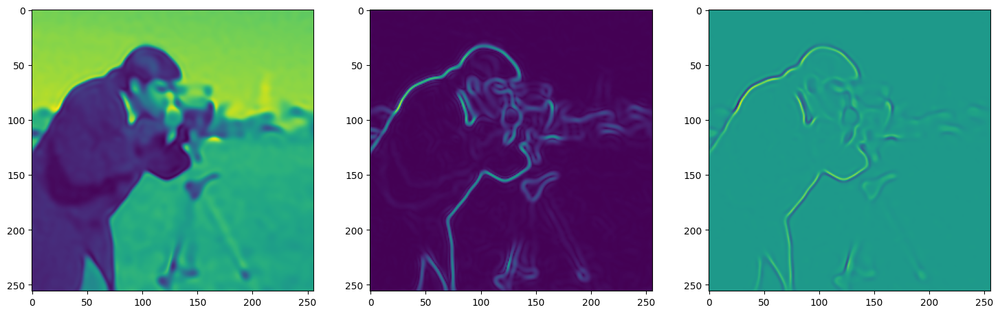

Step 100, Total loss 0.008052


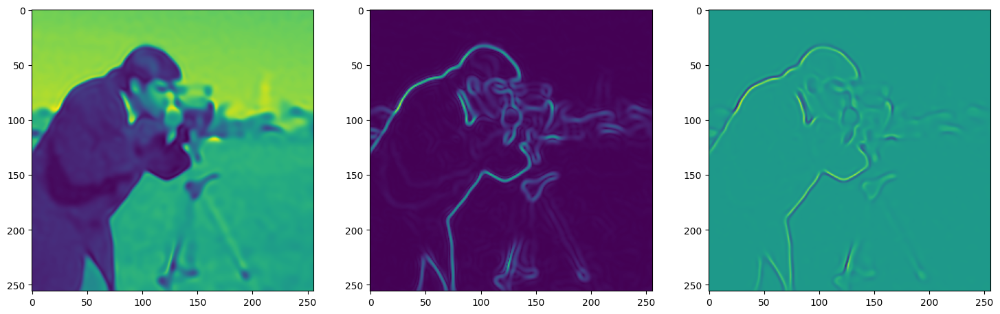

Step 110, Total loss 0.007553


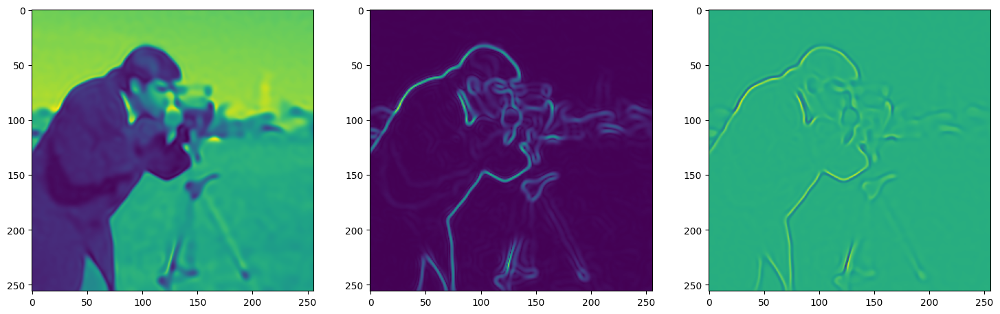

Step 120, Total loss 0.007097


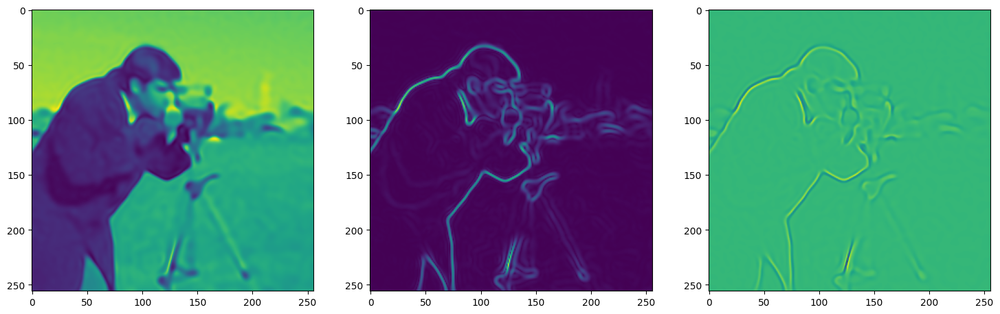

Step 130, Total loss 0.006669


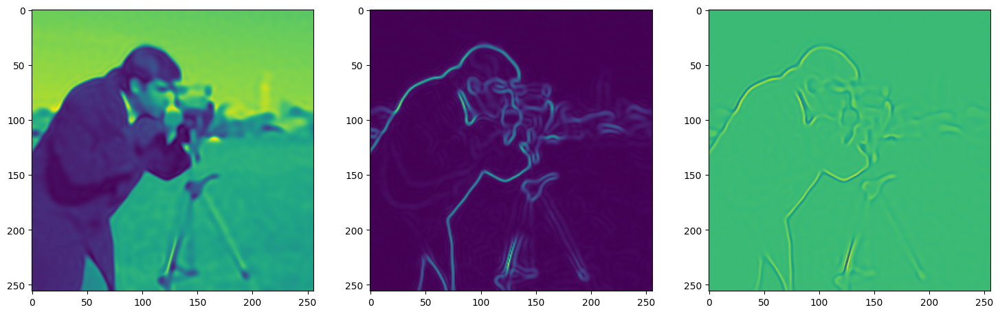

Step 140, Total loss 0.006260


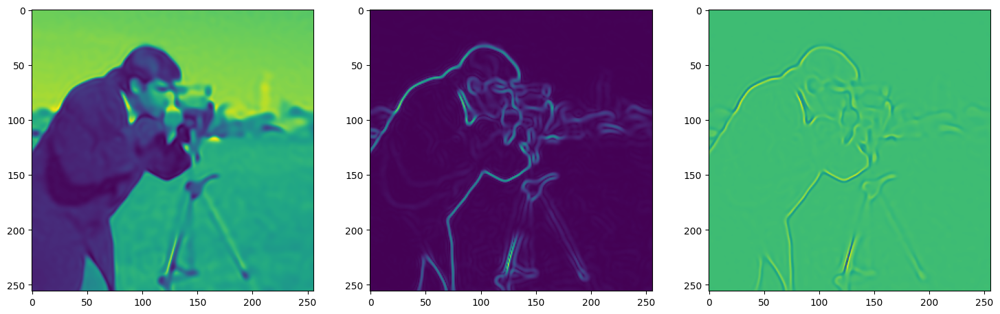

Step 150, Total loss 0.005860


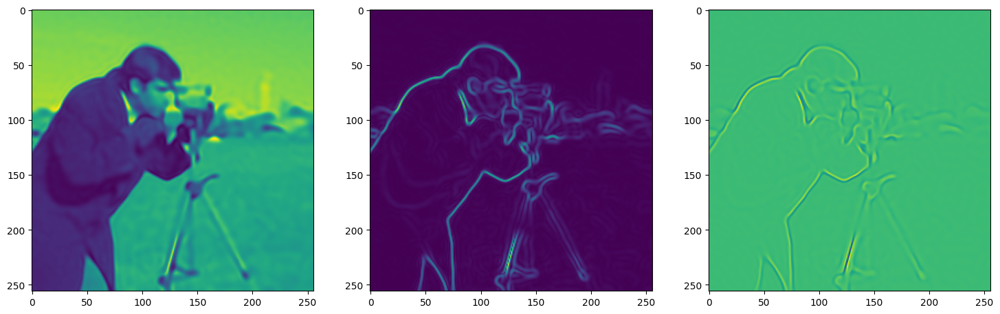

Step 160, Total loss 0.005458


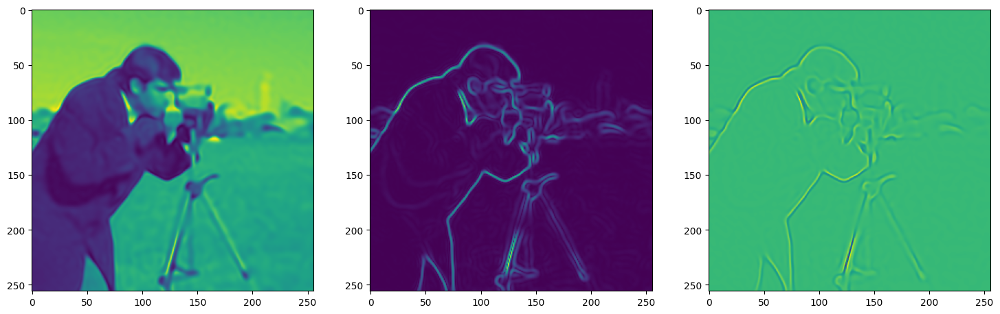

Step 170, Total loss 0.005048


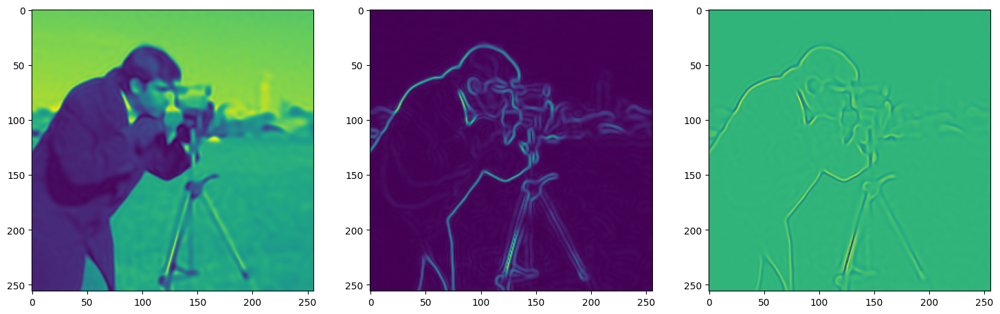

Step 180, Total loss 0.004638


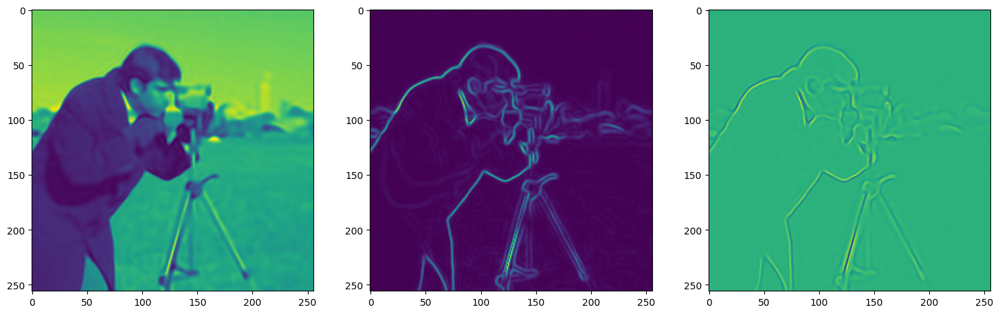

Step 190, Total loss 0.004242


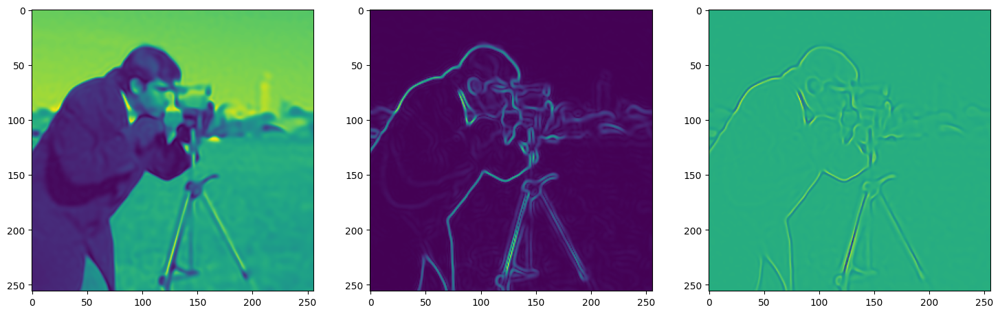

Step 200, Total loss 0.003868


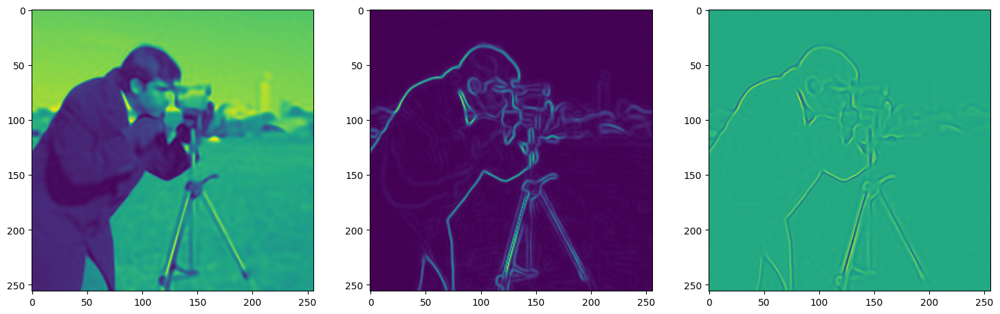

Step 210, Total loss 0.003519


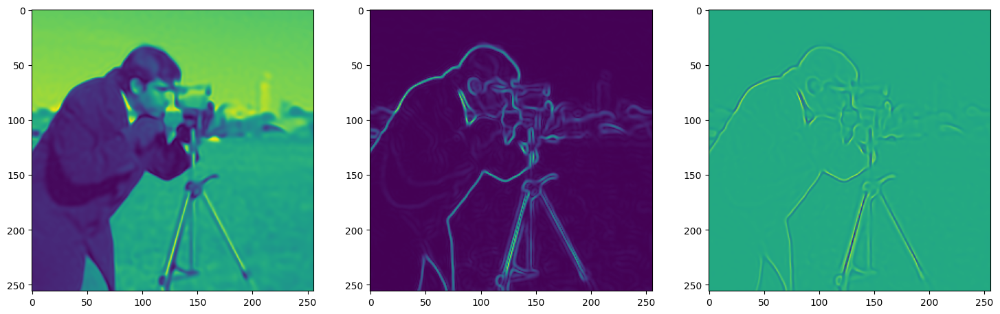

Step 220, Total loss 0.003200


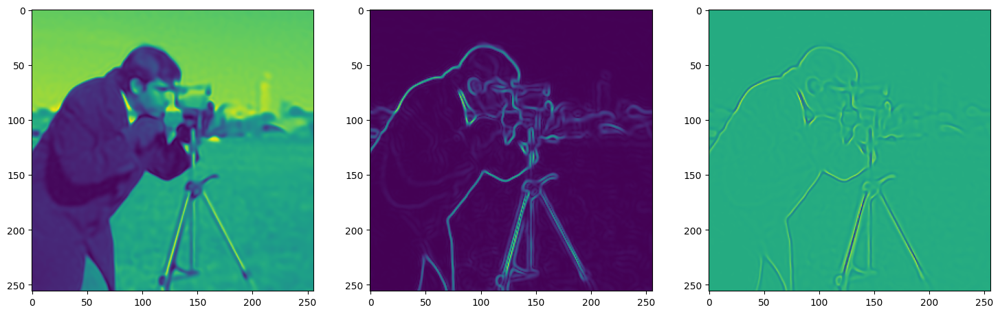

Step 230, Total loss 0.002930


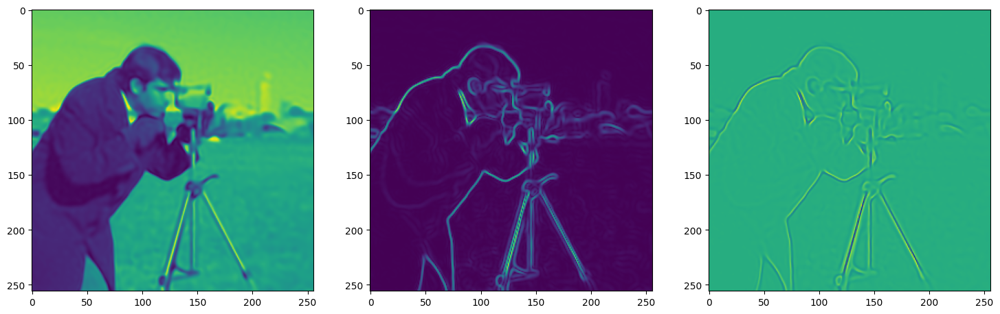

Step 240, Total loss 0.002712


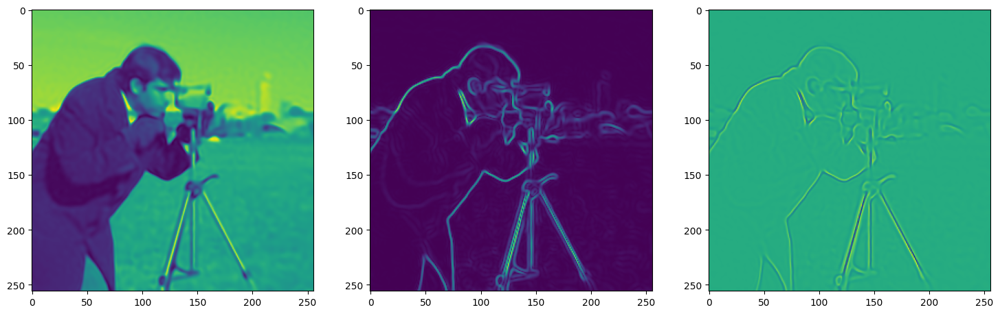

Step 250, Total loss 0.002533


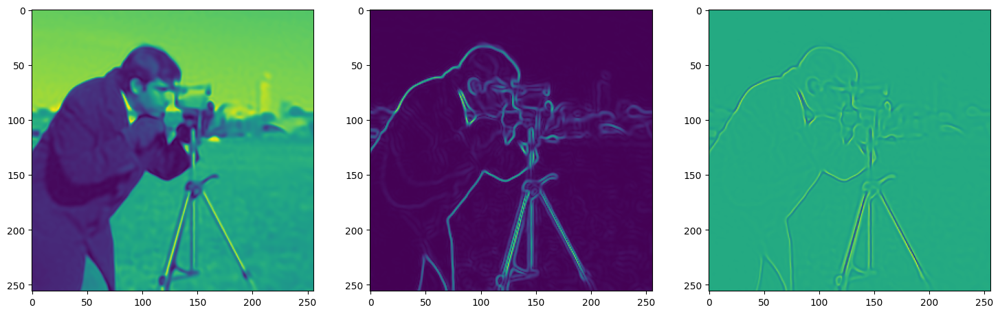

Step 260, Total loss 0.002381


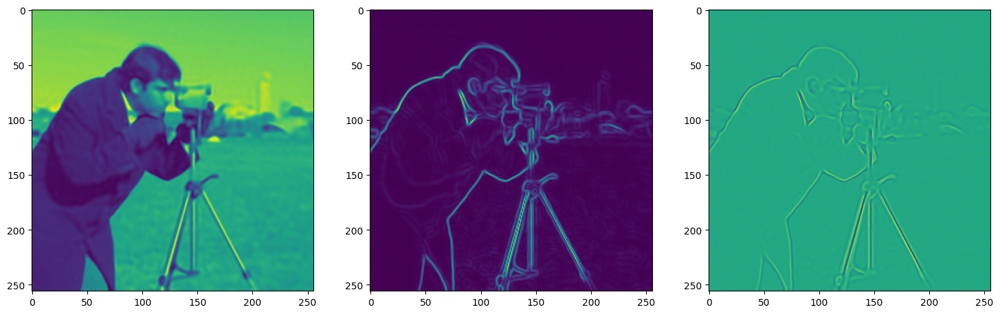

Step 270, Total loss 0.002247


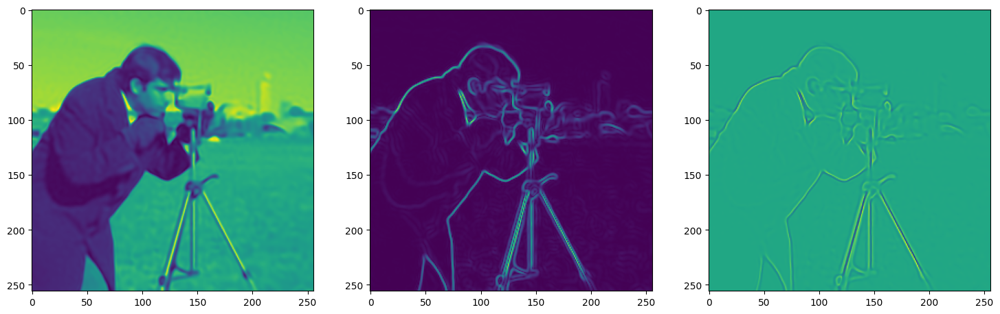

Step 280, Total loss 0.002127


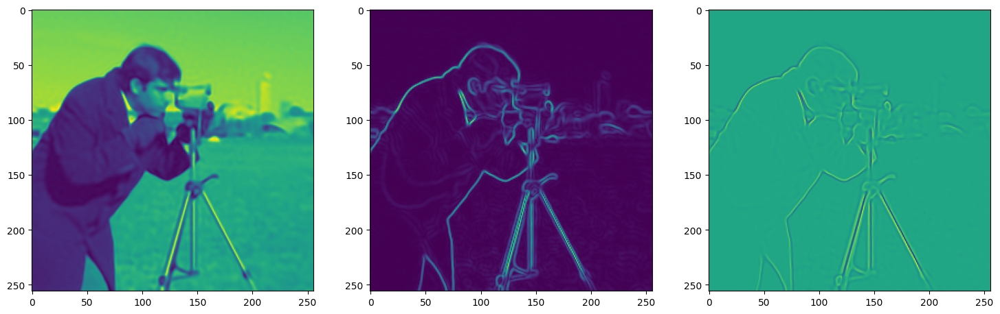

Step 290, Total loss 0.002017


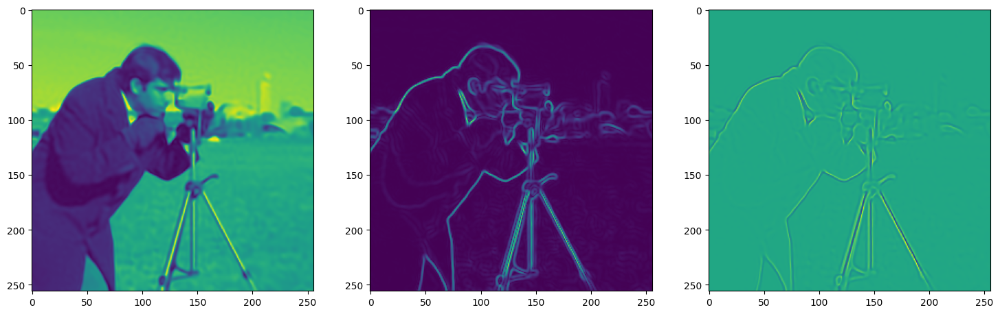

Step 300, Total loss 0.001916


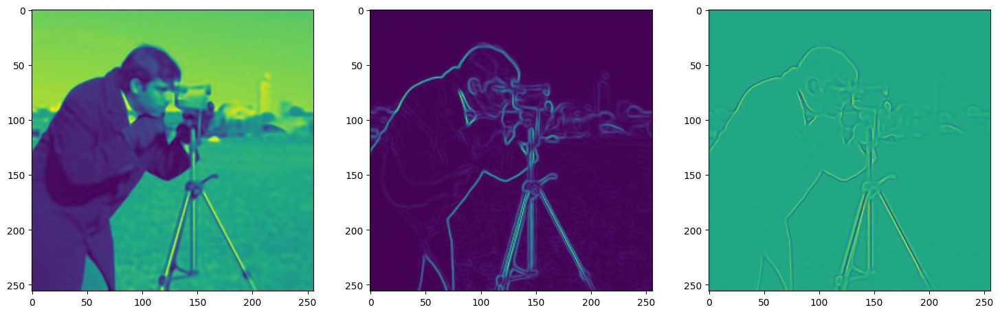

Step 310, Total loss 0.001824


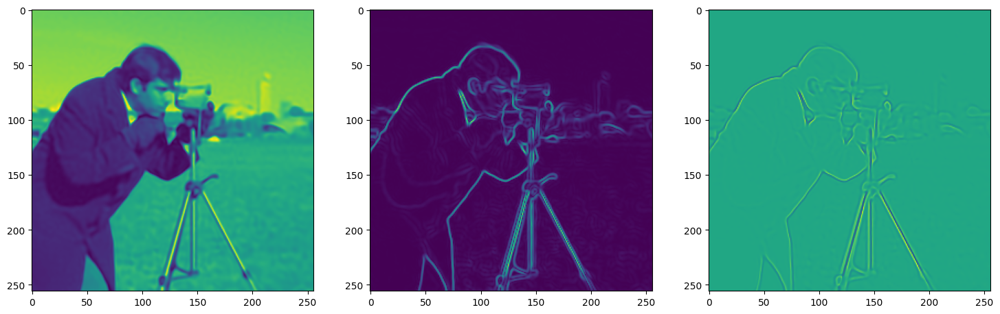

Step 320, Total loss 0.001739


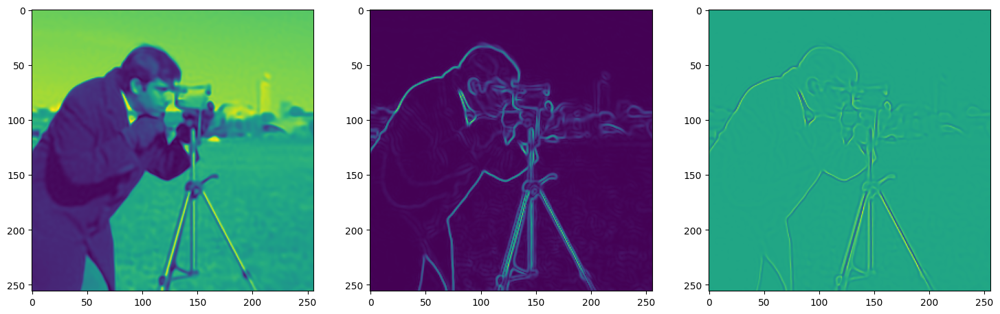

Step 330, Total loss 0.001661


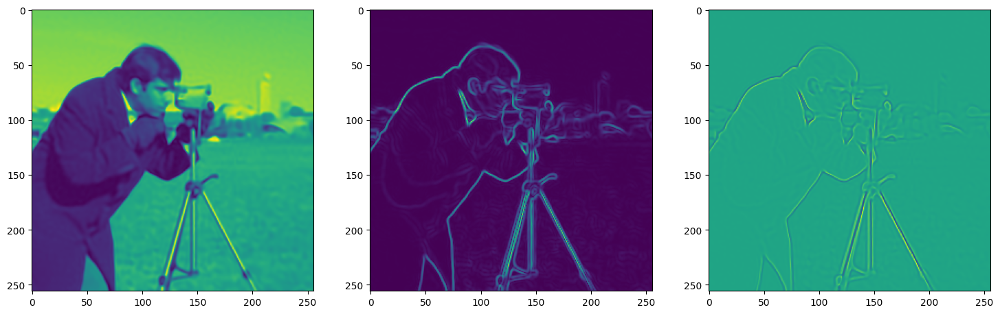

Step 340, Total loss 0.001595


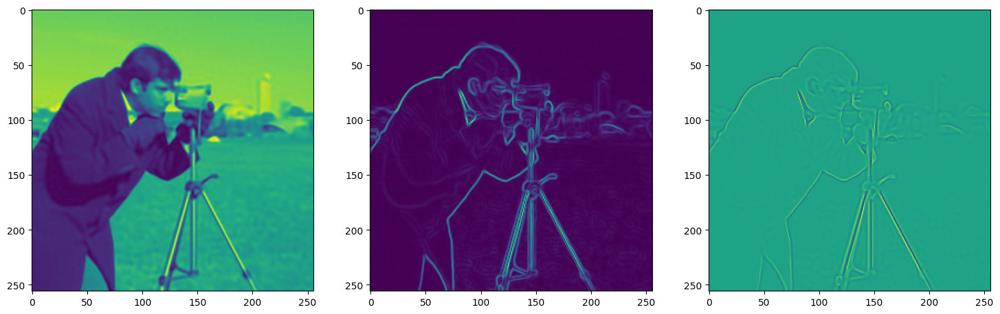

Step 350, Total loss 0.001572


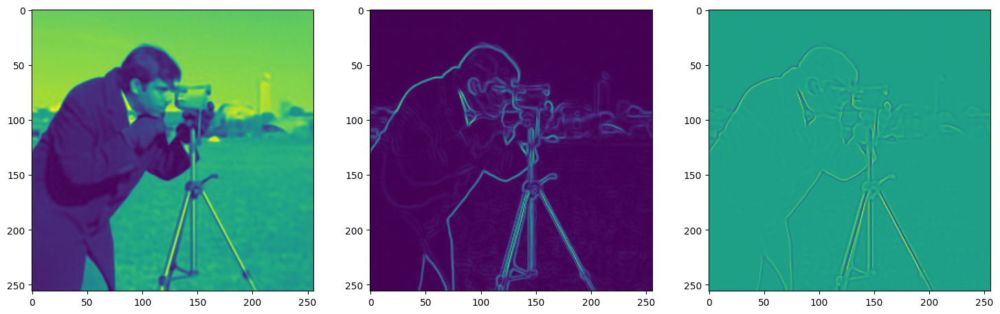

Step 360, Total loss 0.001478


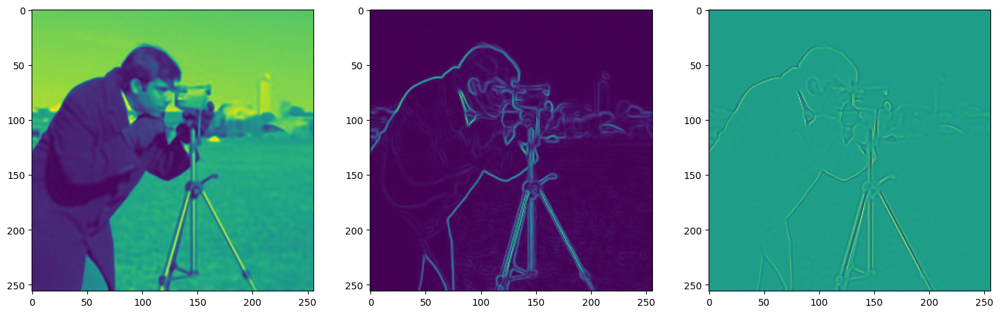

Step 370, Total loss 0.001419


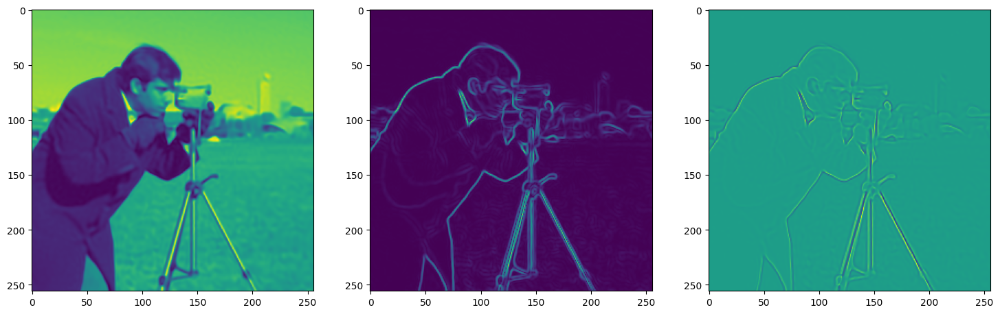

Step 380, Total loss 0.001357


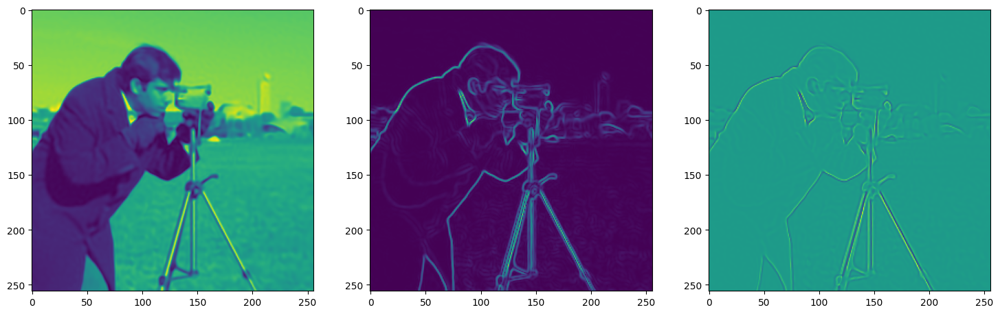

Step 390, Total loss 0.001305


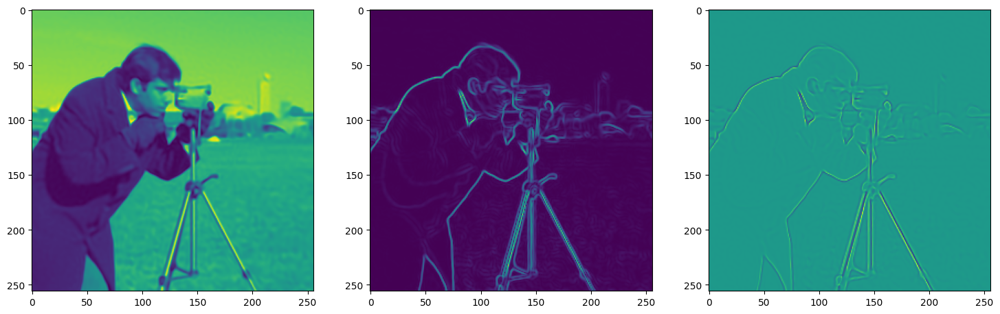

Step 400, Total loss 0.001258


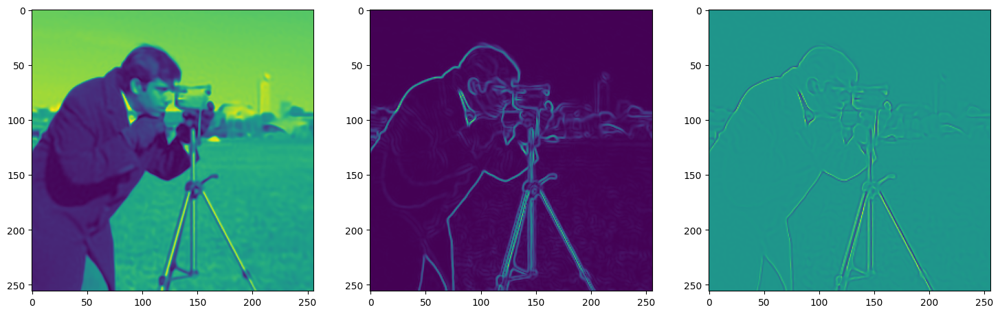

Step 410, Total loss 0.001213


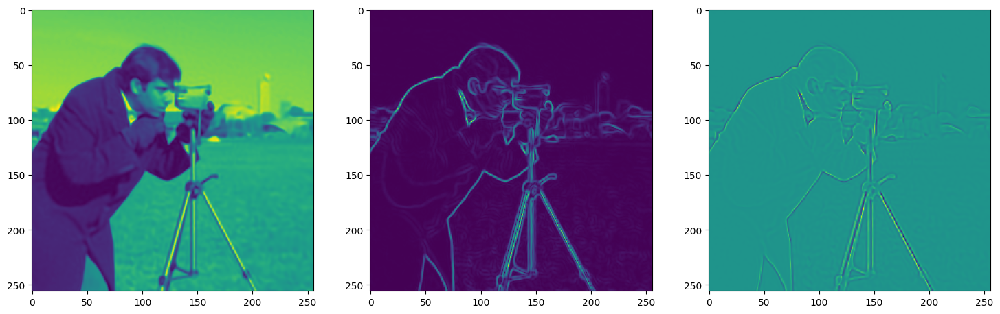

Step 420, Total loss 0.001170


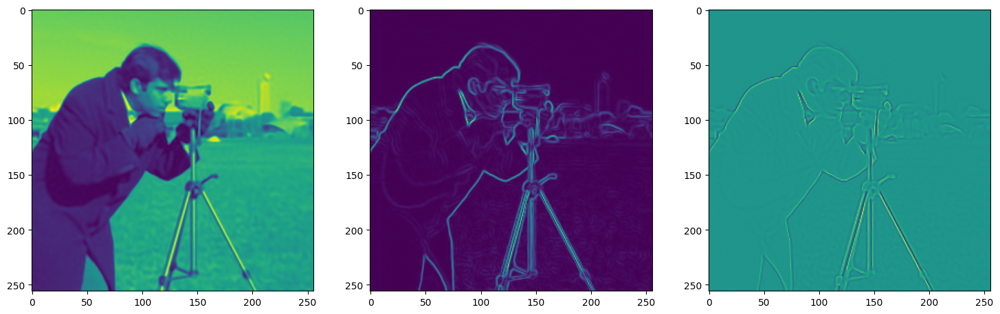

Step 430, Total loss 0.001130


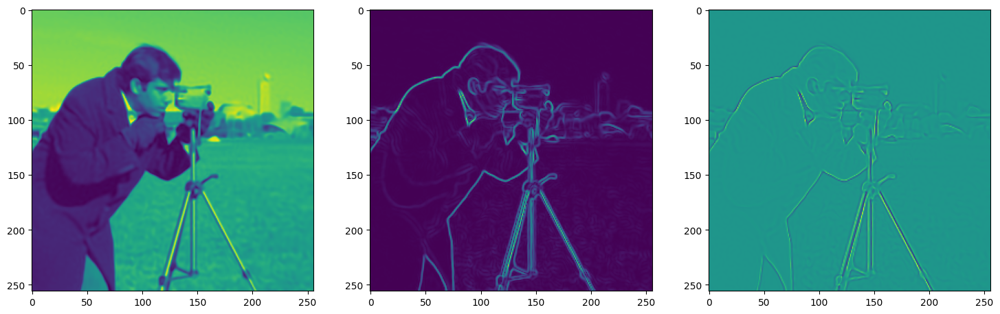

Step 440, Total loss 0.001091


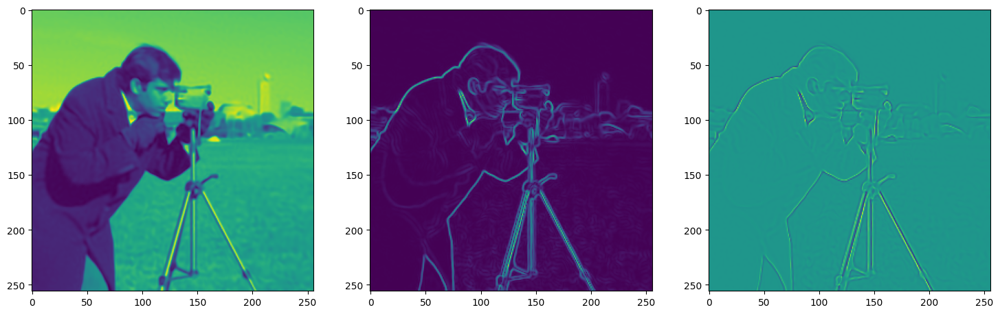

Step 450, Total loss 0.001054


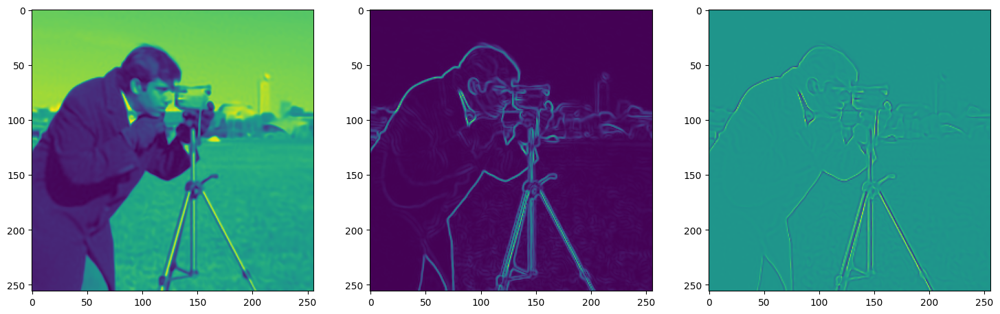

Step 460, Total loss 0.001019


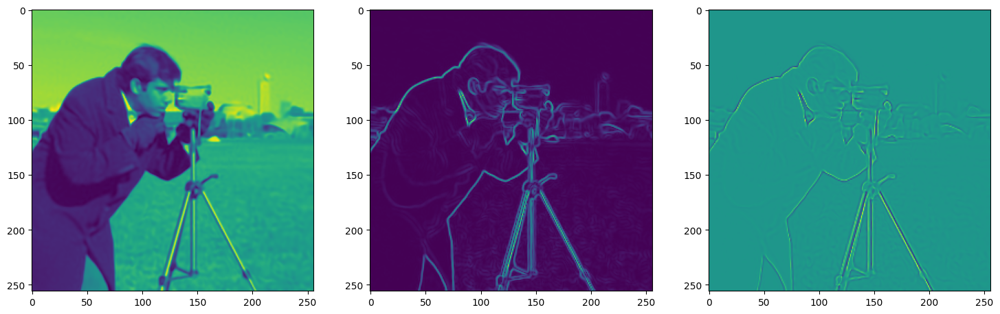

Step 470, Total loss 0.000985


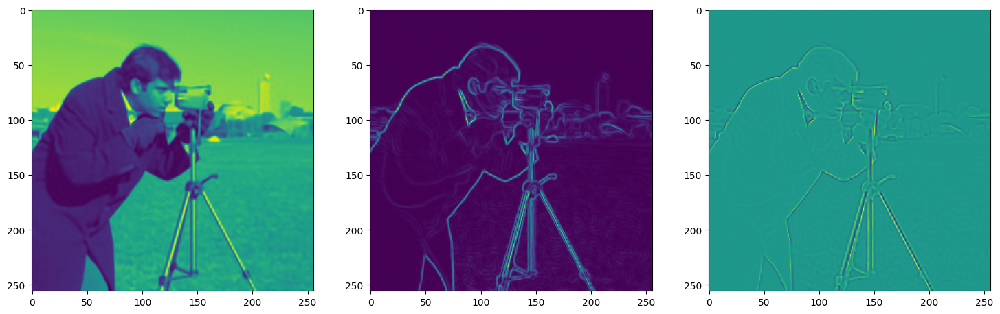

Step 480, Total loss 0.000953


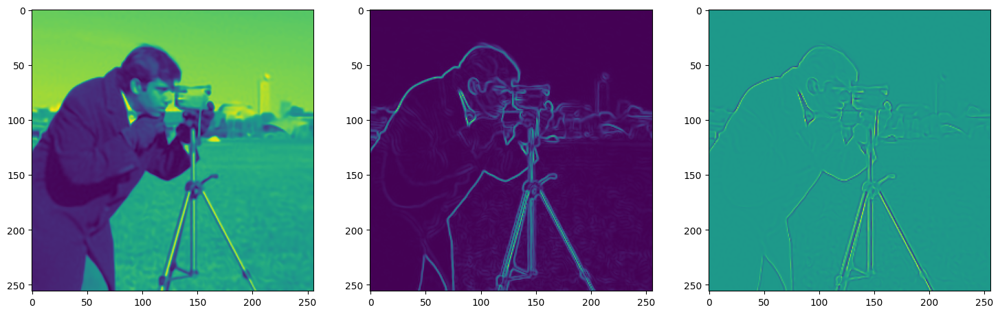

Step 490, Total loss 0.000923


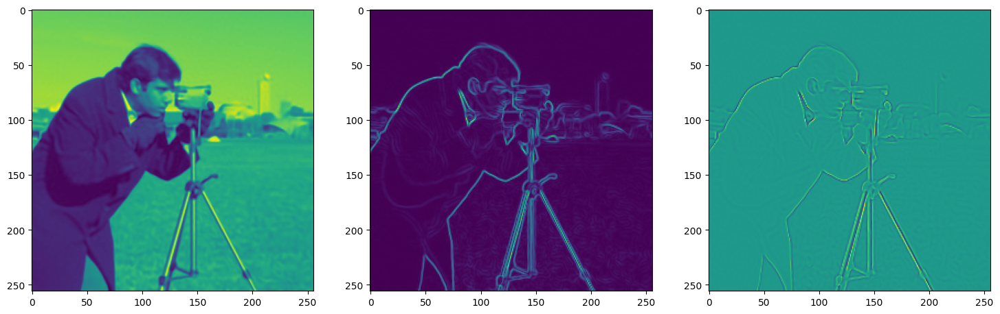

In [9]:
total_steps = 500 # Since the whole image is our dataset, this just means 500 gradient descent steps.
steps_til_summary = 10

optim = torch.optim.Adam(lr=1e-4, params=img_siren.parameters())

model_input, ground_truth = next(iter(dataloader))
model_input, ground_truth = model_input.to(device), ground_truth.to(device)

for step in range(total_steps):
    model_output, coords = img_siren(model_input)    
    loss = ((model_output - ground_truth)**2).mean()
    
    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f" % (step, loss))
        img_grad = gradient(model_output, coords)
        img_laplacian = laplace(model_output, coords)

        fig, axes = plt.subplots(1,3, figsize=(18,6))
        axes[0].imshow(model_output.cpu().view(256,256).detach().numpy())
        axes[1].imshow(img_grad.norm(dim=-1).cpu().view(256,256).detach().numpy())
        axes[2].imshow(img_laplacian.cpu().view(256,256).detach().numpy())
        plt.show()

    optim.zero_grad()
    loss.backward()
    optim.step()

<a id='out_of_range'></a>
## Case study: Siren periodicity & out-of-range behavior

It is known that the sum of two periodic signals is itself periodic with a period that is equal to the least common multiple of the periods of the two summands, if and only if the two periods are rational multiples of each other. If the ratio of the two periods is irrational, then their sum will *not* be periodic itself.

Due to the floating-point representation in neural network libraries, this case cannot occur in practice, and all functions parameterized by Siren indeed have to be periodic.

Yet, the period of the resulting function may in practice be several orders of magnitudes larger than the period of each Siren neuron!

Let's test this with two sines.

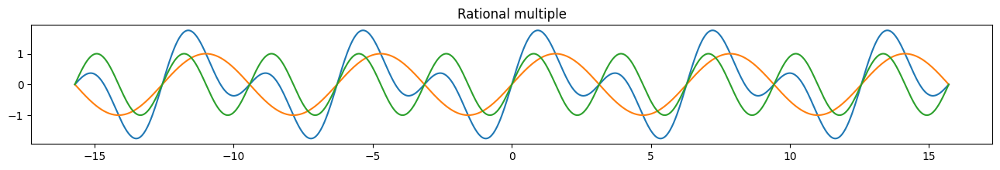

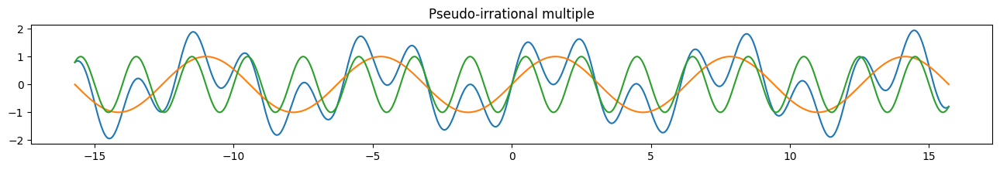

In [10]:
with torch.no_grad():
    coords = get_mgrid(2**10, 1) * 5 * np.pi
    
    sin_1 = torch.sin(coords)
    sin_2 = torch.sin(coords * 2)
    sum = sin_1 + sin_2
    
    fig, ax = plt.subplots(figsize=(16,2))
    ax.plot(coords, sum)
    ax.plot(coords, sin_1)
    ax.plot(coords, sin_2)
    plt.title("Rational multiple")
    plt.show()
    
    sin_1 = torch.sin(coords)
    sin_2 = torch.sin(coords * np.pi)
    sum = sin_1 + sin_2
    
    fig, ax = plt.subplots(figsize=(16,2))
    ax.plot(coords, sum)
    ax.plot(coords, sin_1)
    ax.plot(coords, sin_2)
    plt.title("Pseudo-irrational multiple")
    plt.show()

Though the second plot looks periodic, closer inspection shows that the period of the blue line is indeed larger than the range we're sampling here. 

Let's take a look at what the Siren we just trained looks like outside its training domain!

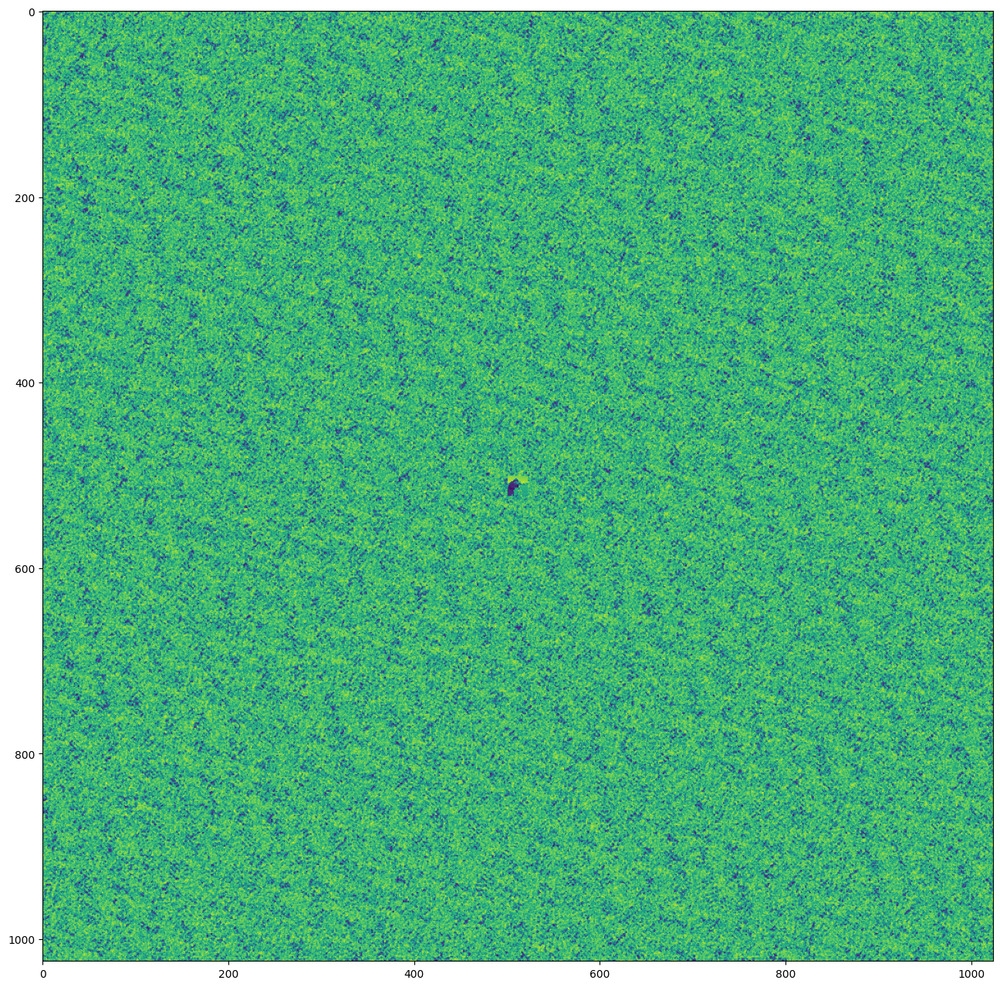

In [11]:
with torch.no_grad():
    out_of_range_coords = get_mgrid(1024, 2) * 50
    model_out, _ = img_siren(out_of_range_coords.to(device))
    
    fig, ax = plt.subplots(figsize=(16,16))
    ax.imshow(model_out.cpu().view(1024,1024).numpy())
    plt.show()

Though there is some self-similarity, the signal is not repeated on this range of (-50, 50).

As we can see, within few iterations, Siren has approximated the audio signal very well!

<a id='section_3'></a>
## Solving Poisson's equation

Now, let's make it a bit harder. Let's say we want to reconstruct an image but we only have access to its gradients!

That is, we now seek the function $\Phi$ such that:
$\mathcal{L}=\int_{\Omega} \lVert \nabla\Phi(\mathbf{x}) - \nabla f(\mathbf{x}) \rVert\mathrm{d}\mathbf{x}$
 is minimized, in which $\Omega$ is the domain of the image. 

In [12]:
import scipy.ndimage
    
class PoissonEqn(Dataset):
    def __init__(self, sidelength):
        super().__init__()
        img = get_cameraman_tensor(sidelength)
        
        # Compute gradient and laplacian       
        grads_x = scipy.ndimage.sobel(img.numpy(), axis=1).squeeze(0)[..., None]
        grads_y = scipy.ndimage.sobel(img.numpy(), axis=2).squeeze(0)[..., None]
        grads_x, grads_y = torch.from_numpy(grads_x), torch.from_numpy(grads_y)
                
        self.grads = torch.stack((grads_x, grads_y), dim=-1).view(-1, 2)
        self.laplace = scipy.ndimage.laplace(img.numpy()).squeeze(0)[..., None]
        self.laplace = torch.from_numpy(self.laplace)
        
        self.pixels = img.permute(1, 2, 0).view(-1, 1)
        self.coords = get_mgrid(sidelength, 2)

    def __len__(self):
        return 1

    def __getitem__(self, idx):
        return self.coords, {'pixels':self.pixels, 'grads':self.grads, 'laplace':self.laplace}

#### Instantiate SIREN model

ModuleNotFoundError: No module named 'spellbook'

In [13]:
cameraman_poisson = PoissonEqn(128)
dataloader = DataLoader(cameraman_poisson, batch_size=1, pin_memory=True, num_workers=0)

poisson_siren = Siren(in_features=2, out_features=1, hidden_features=256, 
                      hidden_layers=3, outermost_linear=True)
poisson_siren.to(device)

Siren(
  (net): Sequential(
    (0): SineLayer(
      (linear): Linear(in_features=2, out_features=256, bias=True)
    )
    (1): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (2): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (3): SineLayer(
      (linear): Linear(in_features=256, out_features=256, bias=True)
    )
    (4): Linear(in_features=256, out_features=1, bias=True)
  )
)

#### Define the loss function

In [14]:
def gradients_mse(model_output, coords, gt_gradients):
    # compute gradients on the model
    gradients = gradient(model_output, coords)
    # compare them with the ground-truth
    gradients_loss = torch.mean((gradients - gt_gradients).pow(2).sum(-1))
    return gradients_loss

#### Train the model

Step 0, Total loss 15.985051, iteration time 0.001922


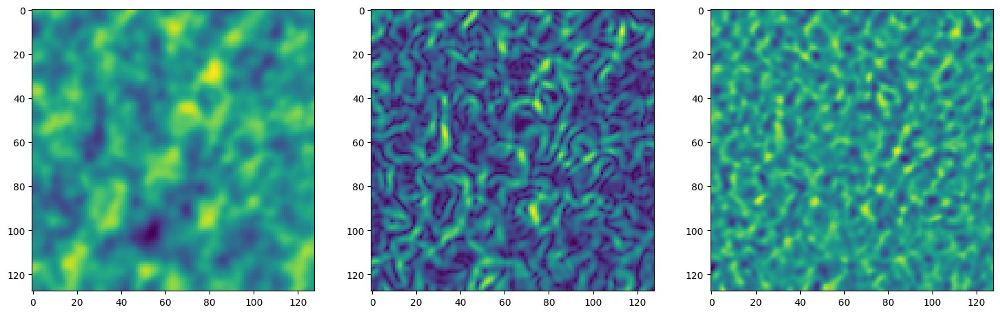

Step 10, Total loss 4.642030, iteration time 0.004044


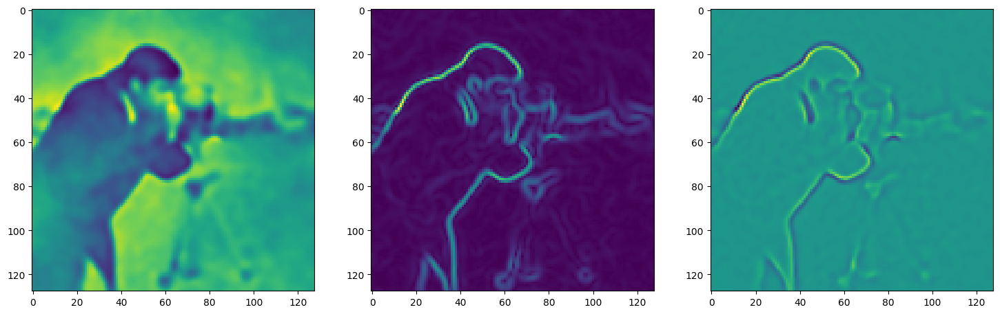

Step 20, Total loss 1.834594, iteration time 0.004060


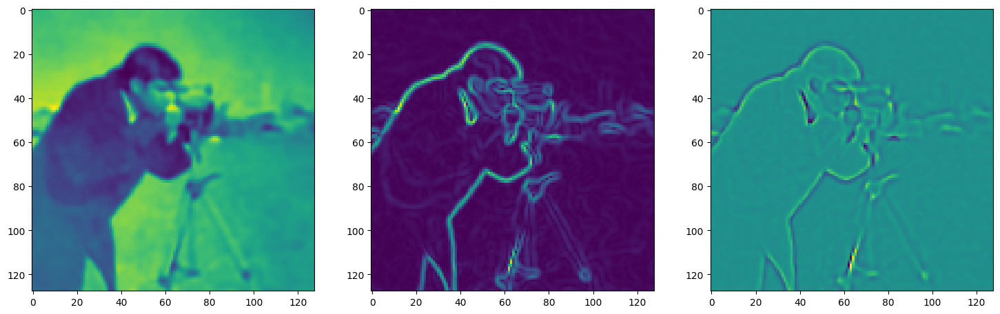

Step 30, Total loss 0.786663, iteration time 0.004140


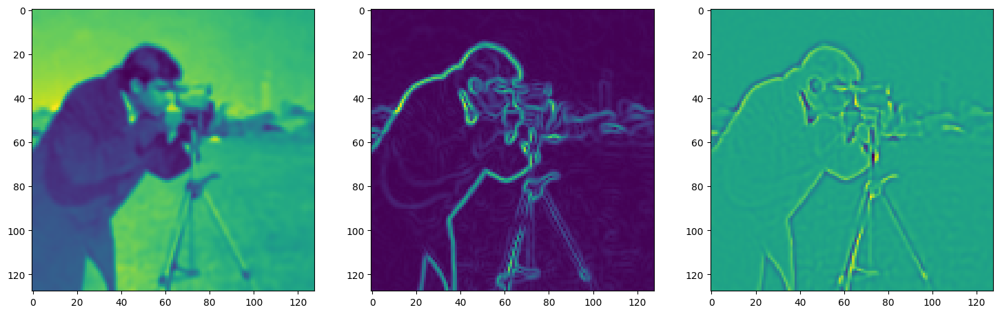

Step 40, Total loss 0.354980, iteration time 0.004026


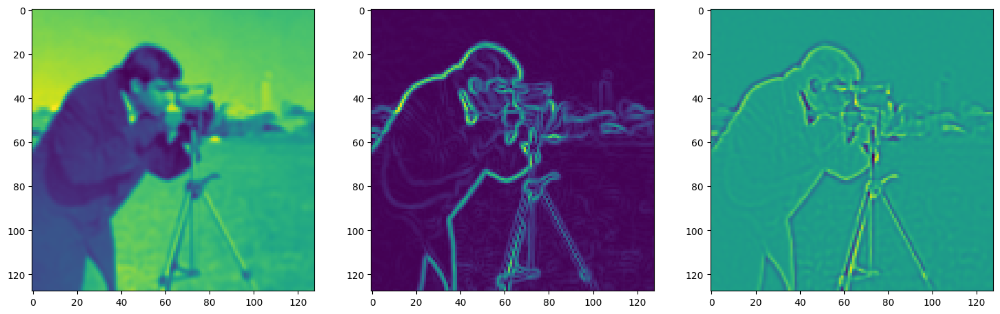

Step 50, Total loss 0.227127, iteration time 0.004005


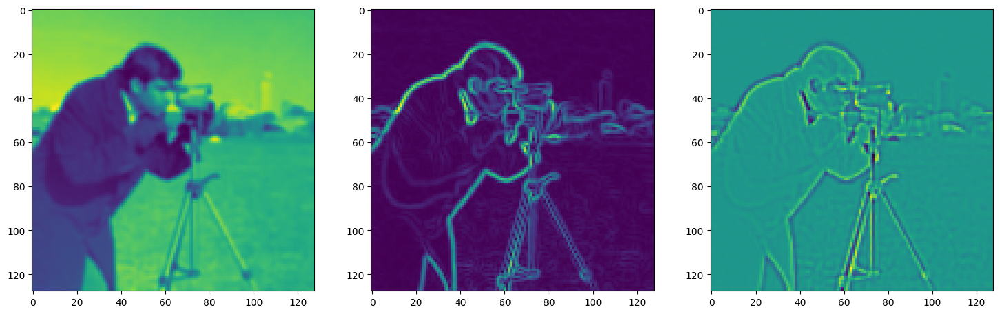

Step 60, Total loss 0.130348, iteration time 0.004109


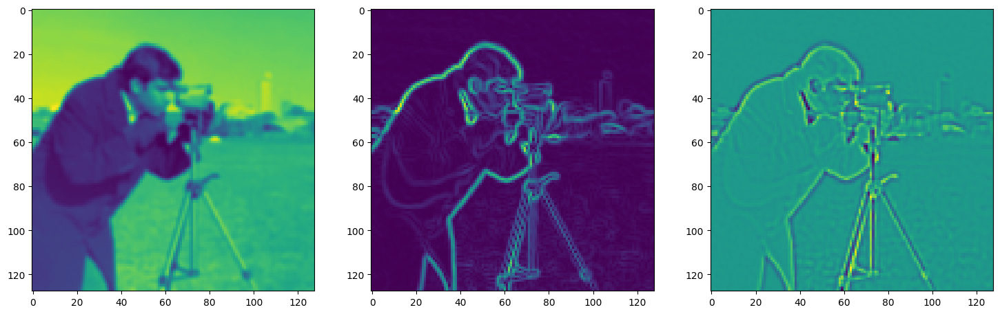

Step 70, Total loss 0.093863, iteration time 0.004099


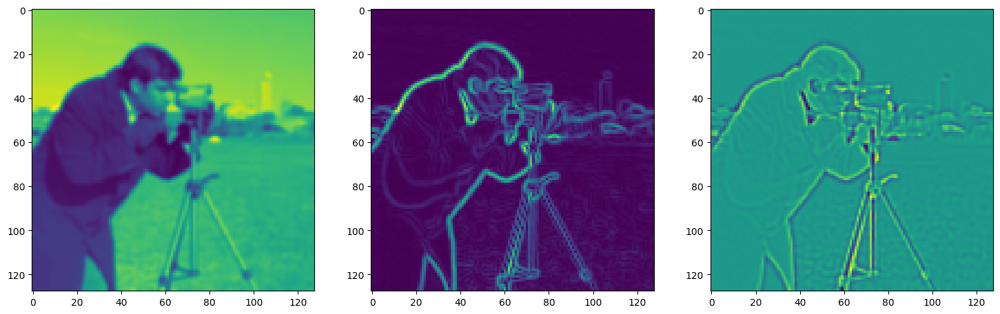

Step 80, Total loss 0.077622, iteration time 0.004038


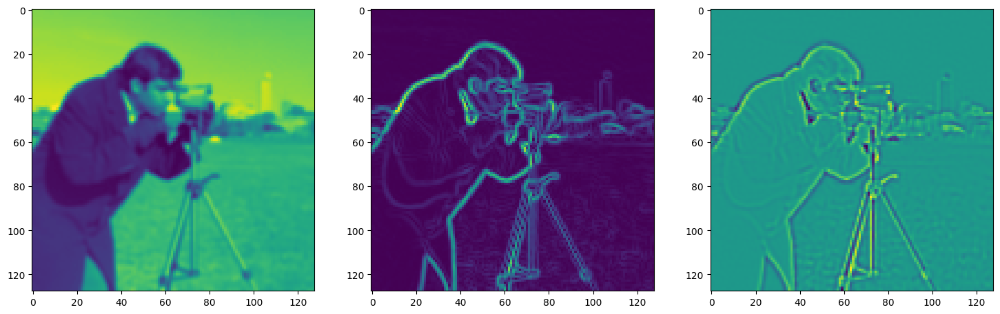

Step 90, Total loss 0.062409, iteration time 0.004059


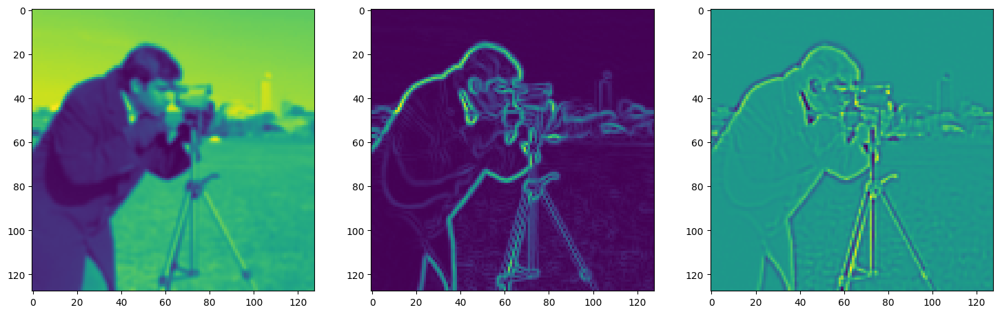

Step 100, Total loss 0.145922, iteration time 0.004219


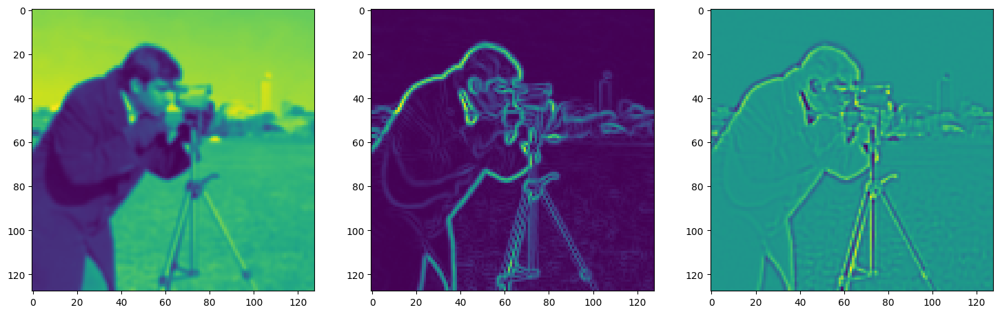

Step 110, Total loss 0.050345, iteration time 0.004082


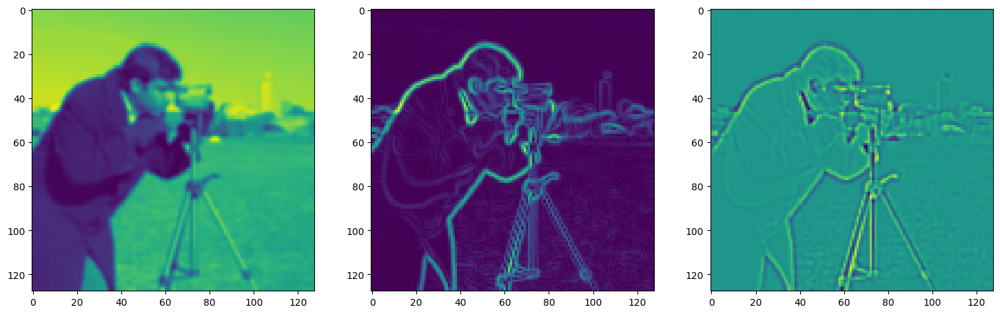

Step 120, Total loss 0.047253, iteration time 0.004044


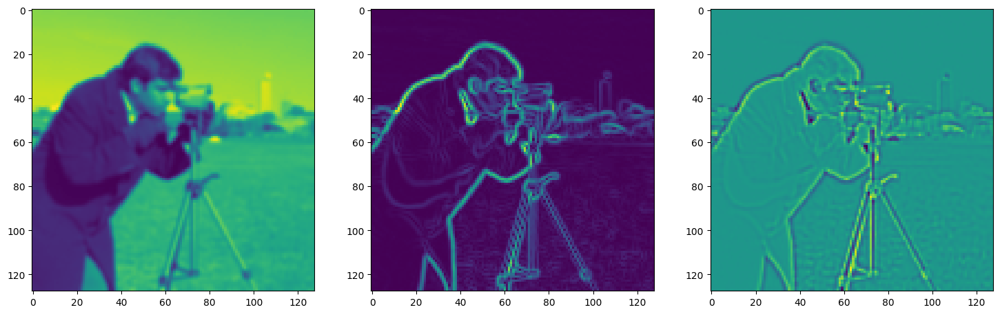

Step 130, Total loss 0.041965, iteration time 0.004001


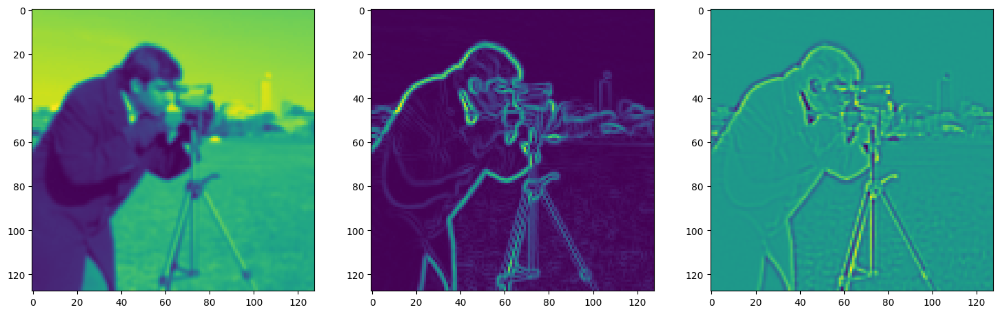

Step 140, Total loss 0.036476, iteration time 0.004041


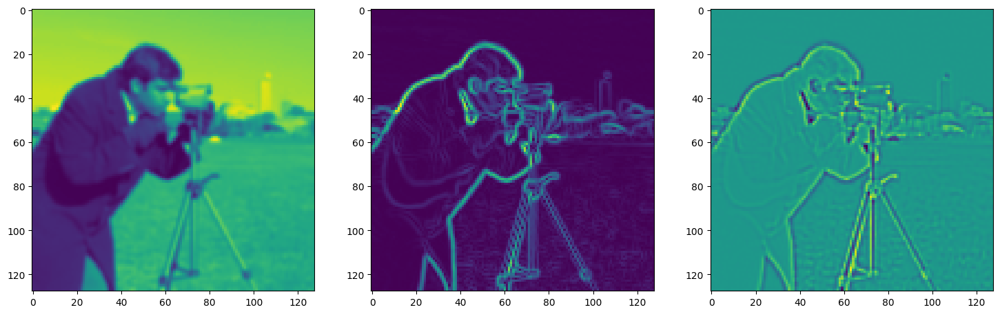

Step 150, Total loss 0.033452, iteration time 0.004043


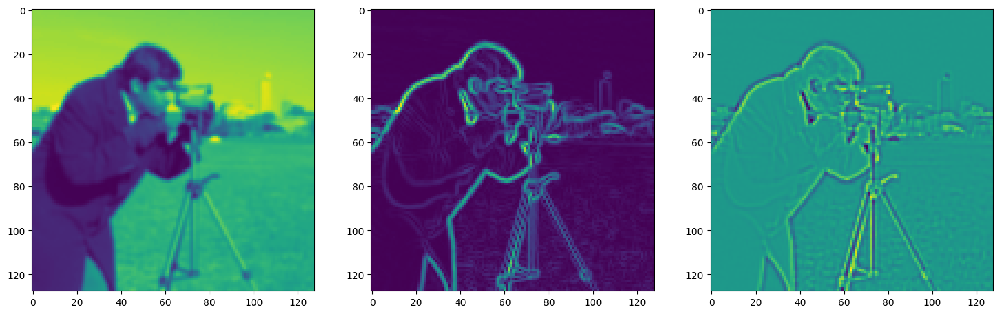

Step 160, Total loss 0.031040, iteration time 0.004028


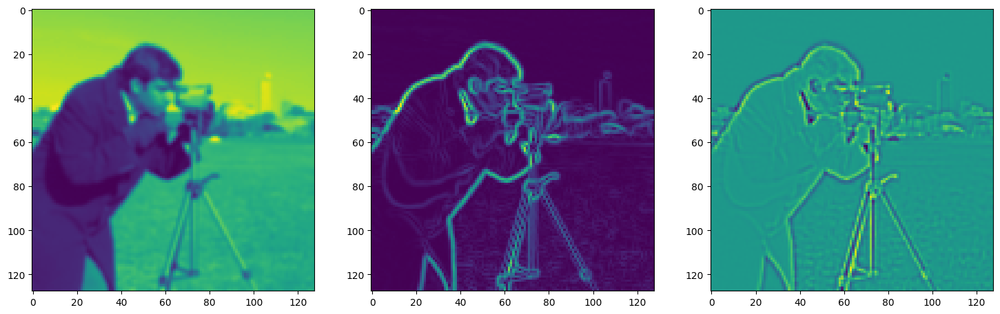

Step 170, Total loss 0.052693, iteration time 0.003981


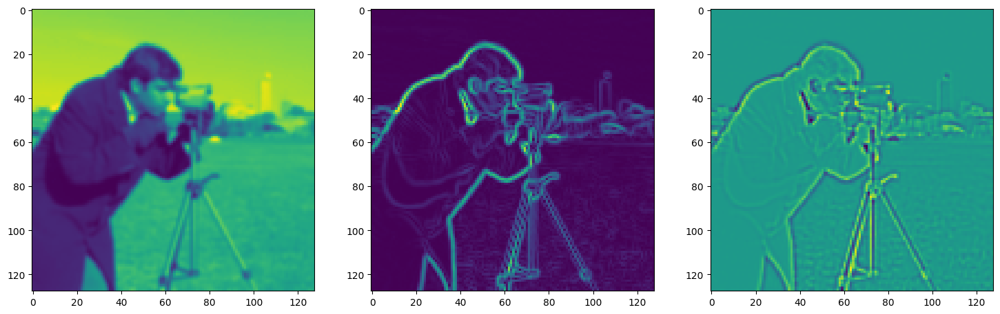

Step 180, Total loss 0.034200, iteration time 0.004116


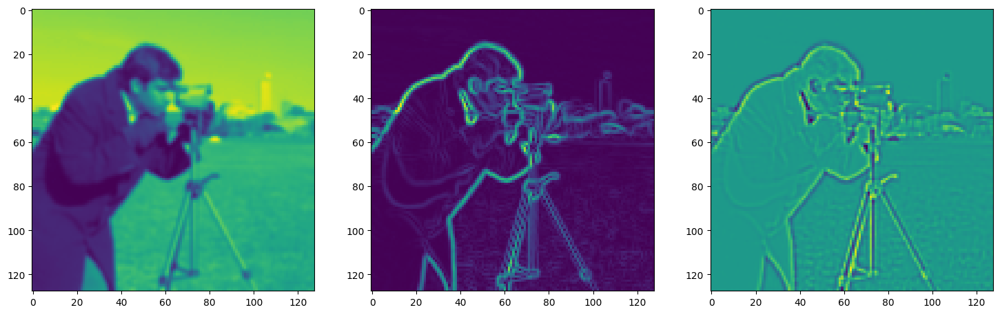

Step 190, Total loss 0.027935, iteration time 0.004142


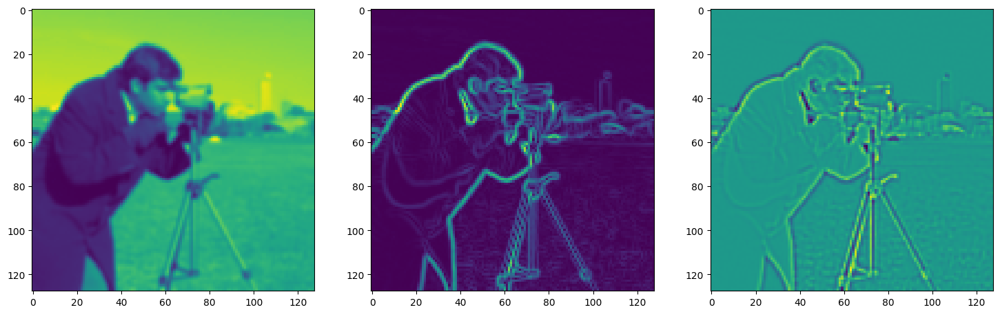

Step 200, Total loss 0.040797, iteration time 0.003993


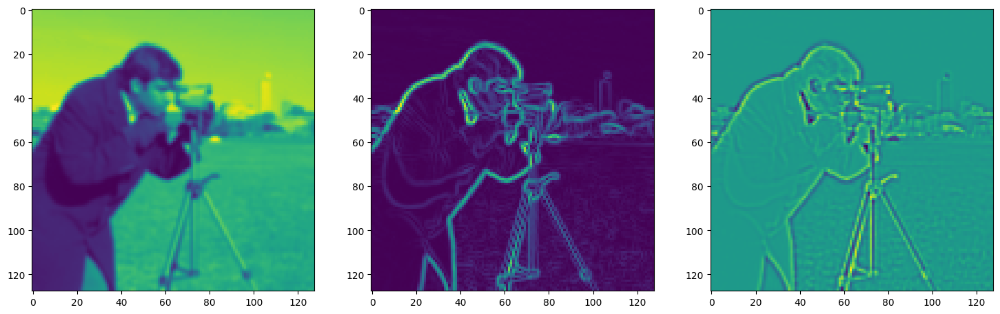

Step 210, Total loss 0.025059, iteration time 0.004024


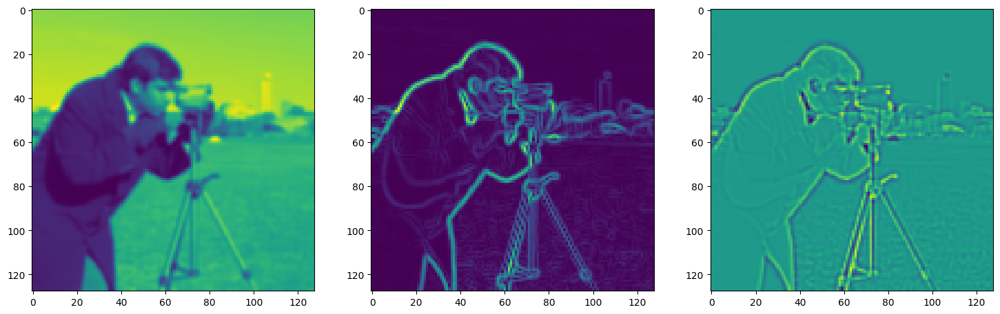

Step 220, Total loss 0.022865, iteration time 0.004067


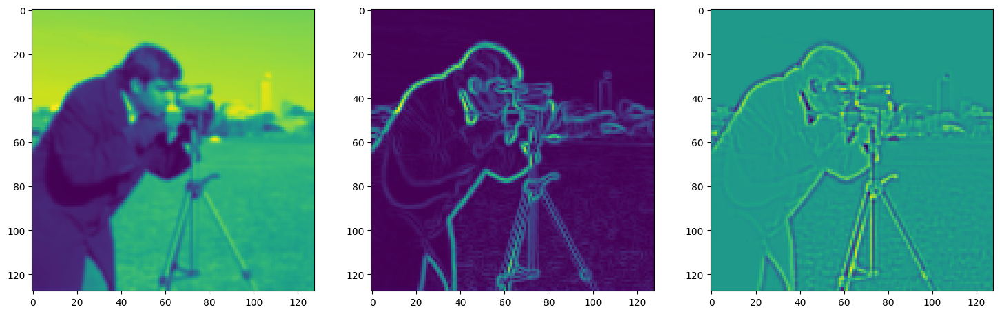

Step 230, Total loss 0.021499, iteration time 0.004143


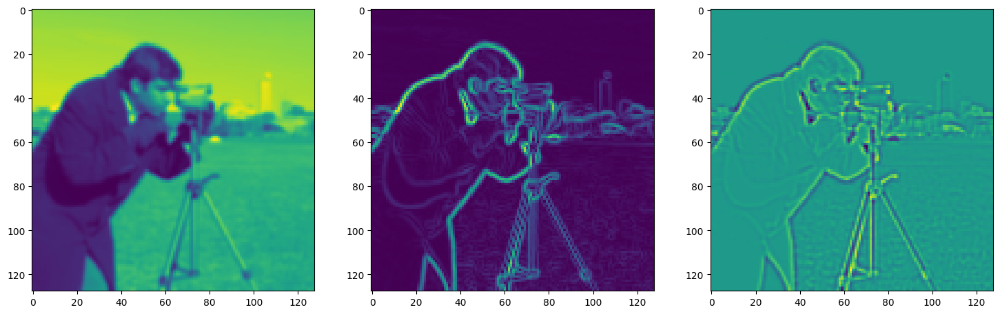

Step 240, Total loss 0.020581, iteration time 0.004068


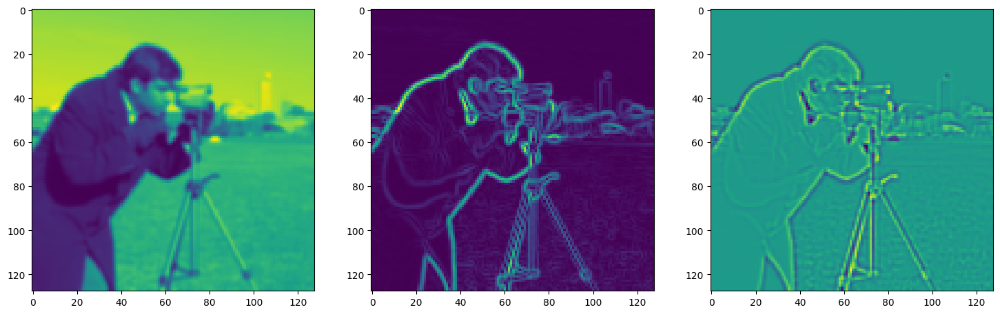

Step 250, Total loss 0.019829, iteration time 0.004055


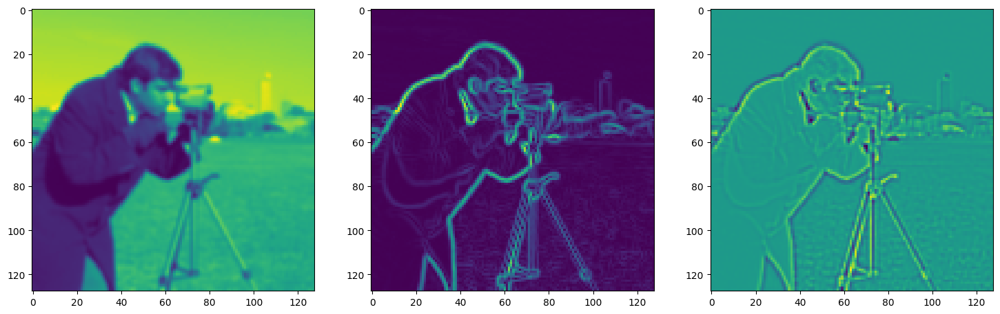

Step 260, Total loss 0.046011, iteration time 0.004068


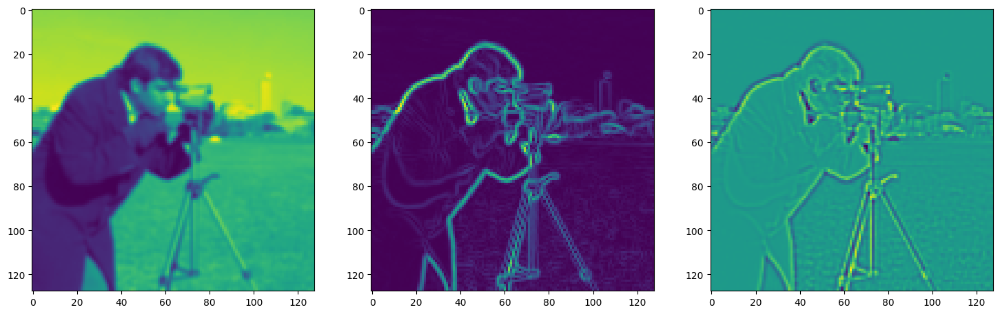

Step 270, Total loss 0.034686, iteration time 0.004175


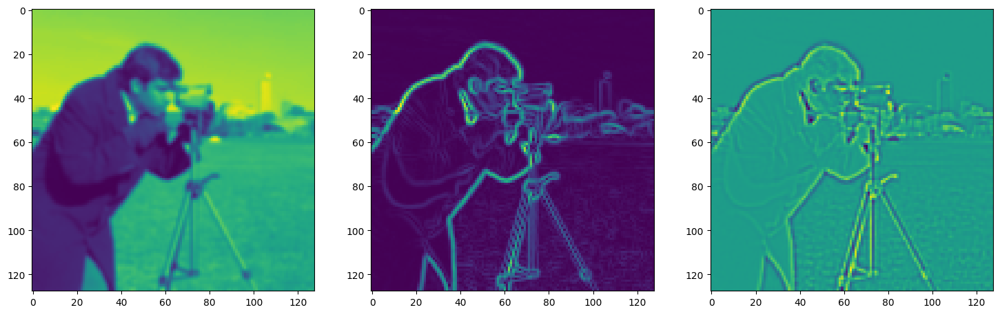

Step 280, Total loss 0.021305, iteration time 0.003997


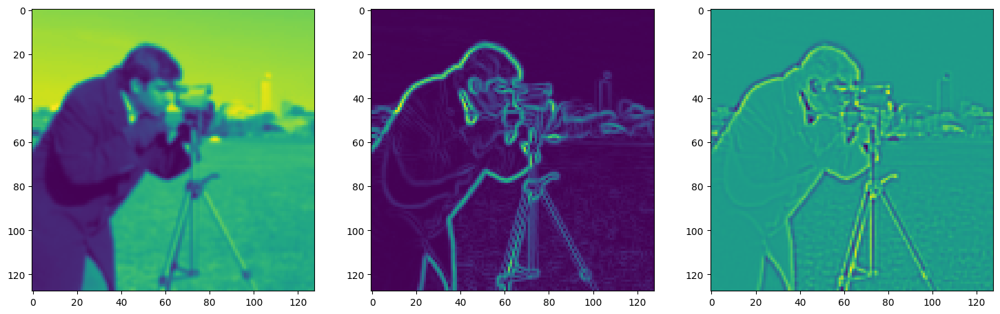

Step 290, Total loss 0.018912, iteration time 0.002644


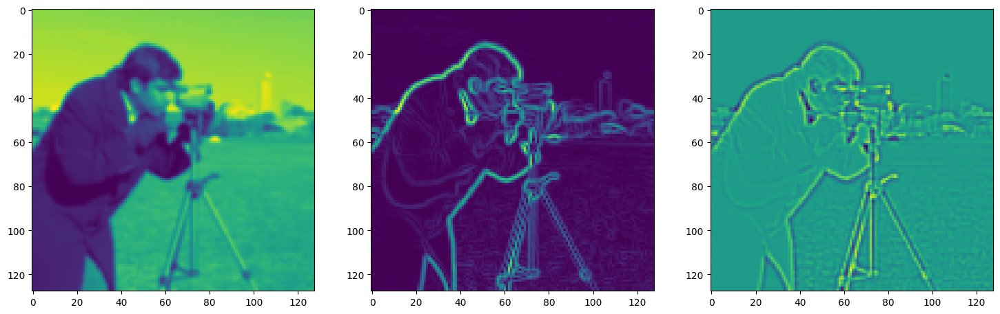

Step 300, Total loss 0.017306, iteration time 0.003322


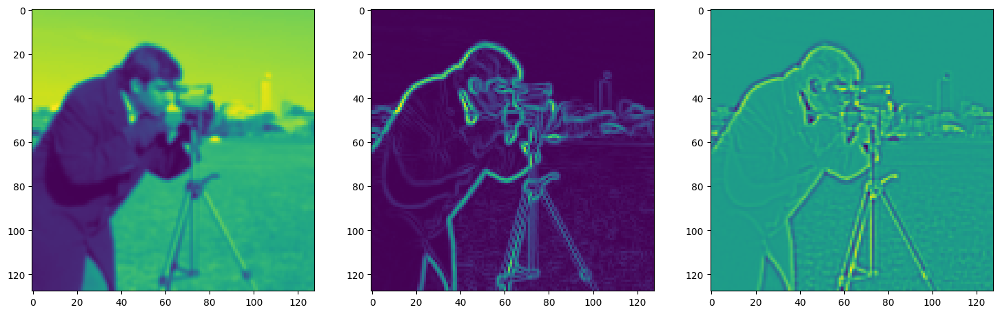

Step 310, Total loss 0.016436, iteration time 0.008090


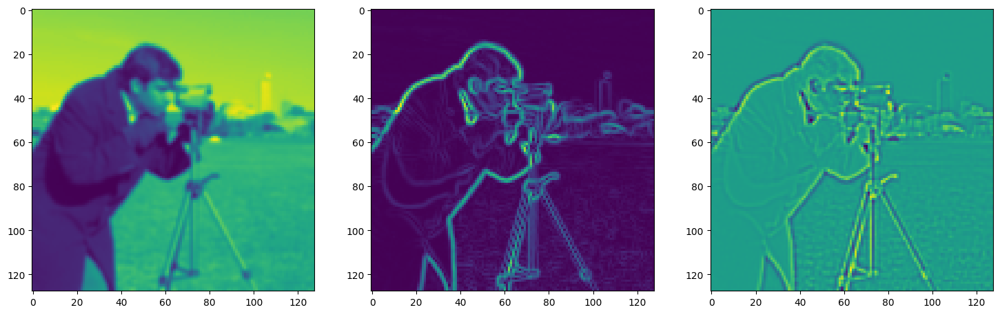

Step 320, Total loss 0.015918, iteration time 0.004496


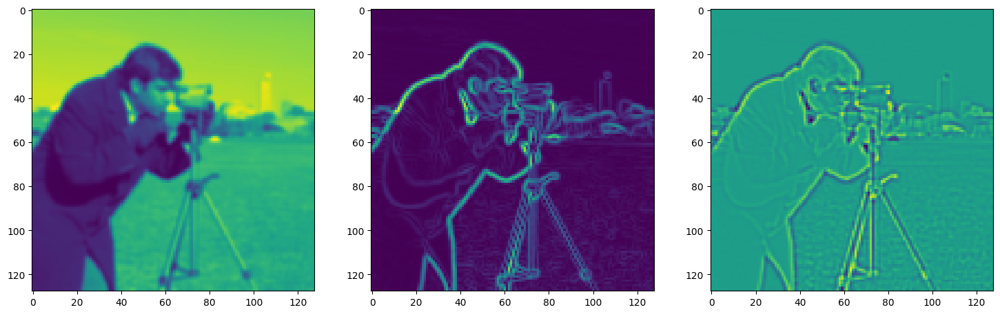

Step 330, Total loss 0.015470, iteration time 0.011066


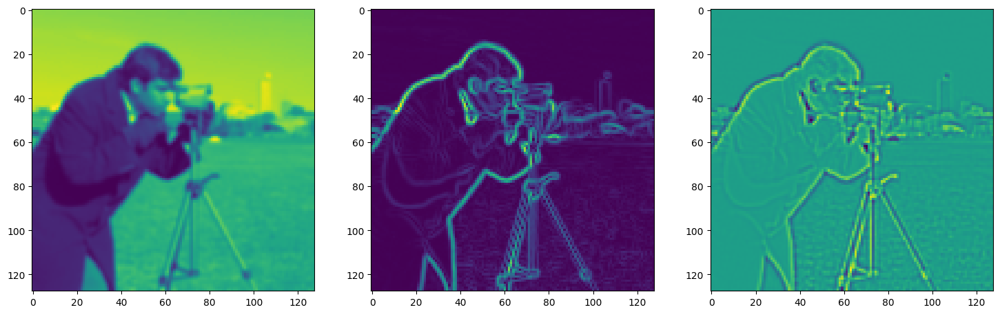

Step 340, Total loss 0.015048, iteration time 0.004514


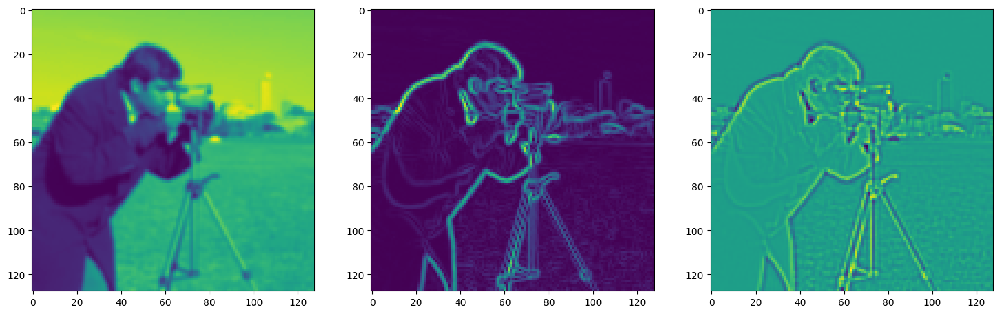

Step 350, Total loss 0.014659, iteration time 0.004558


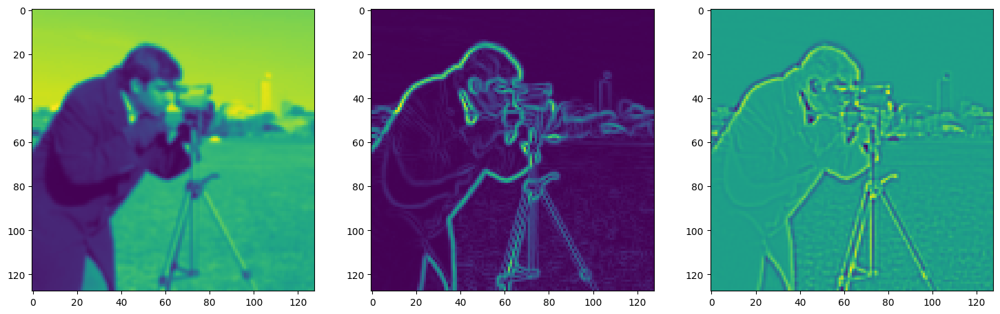

Step 360, Total loss 0.014340, iteration time 0.004049


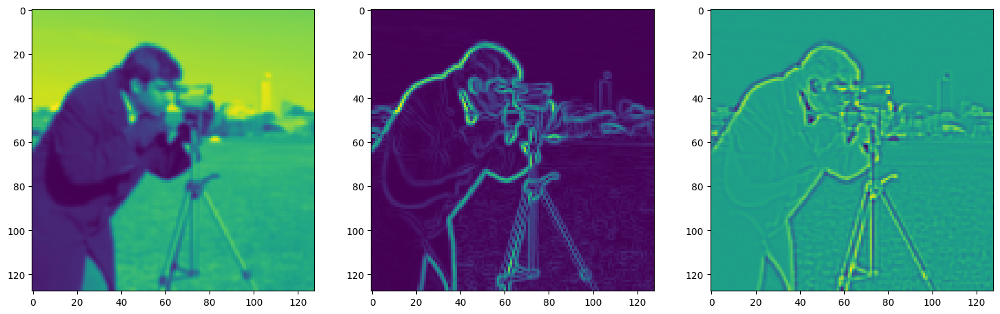

Step 370, Total loss 0.028612, iteration time 0.004017


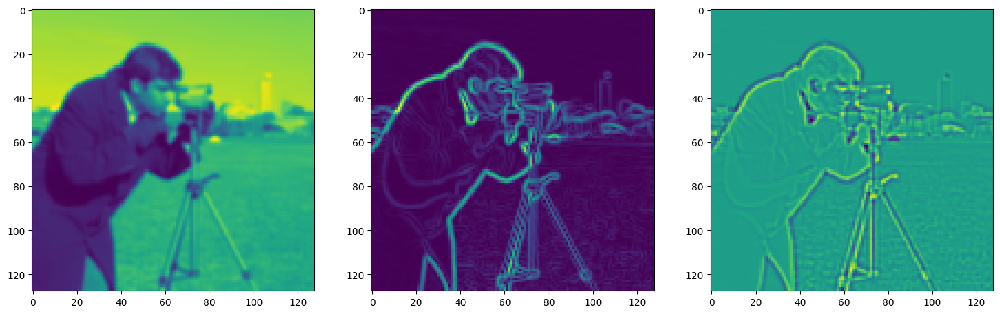

Step 380, Total loss 0.017654, iteration time 0.004068


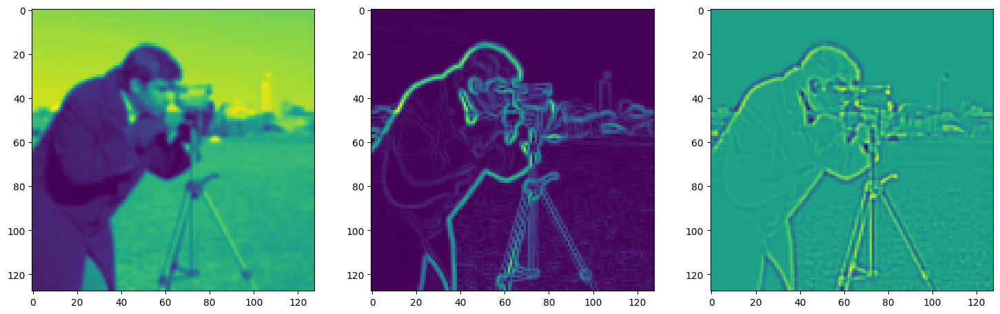

Step 390, Total loss 0.014688, iteration time 0.003989


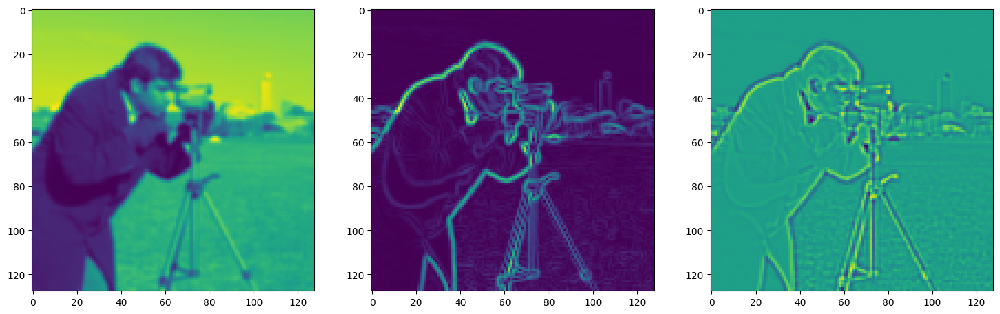

Step 400, Total loss 0.013871, iteration time 0.004022


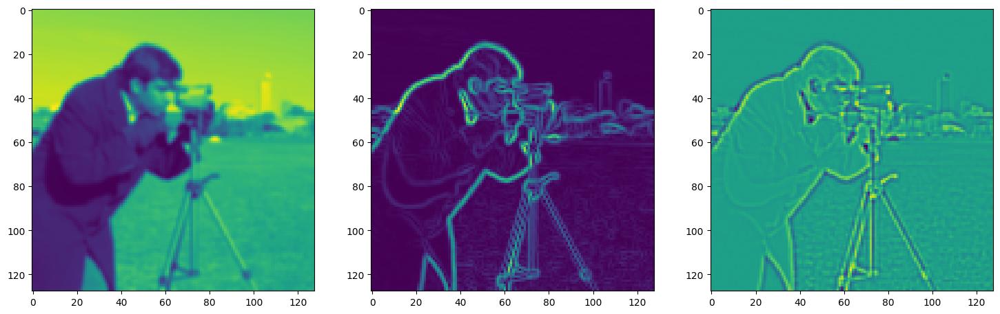

Step 410, Total loss 0.013067, iteration time 0.003970


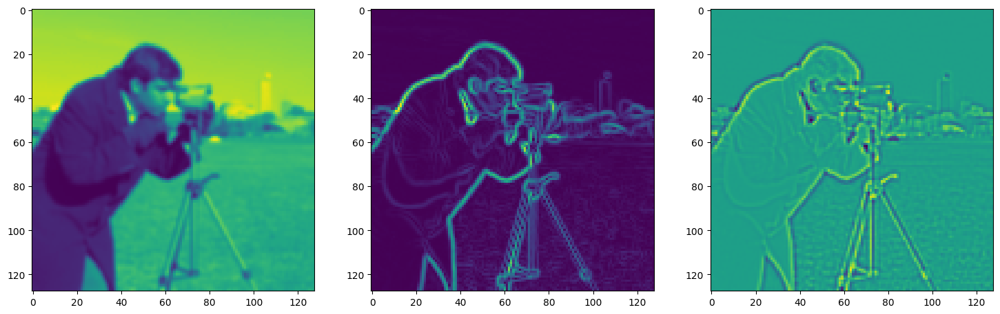

Step 420, Total loss 0.012652, iteration time 0.004256


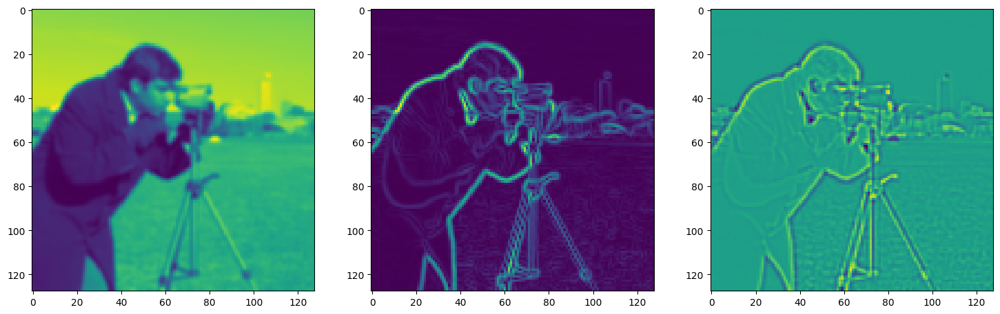

Step 430, Total loss 0.012362, iteration time 0.003984


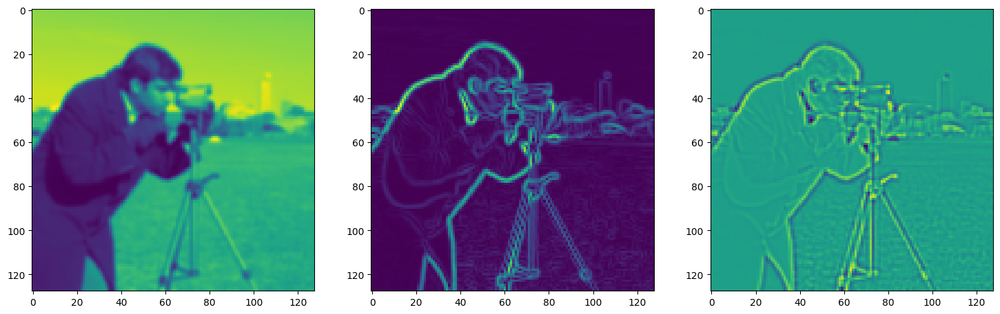

Step 440, Total loss 0.012387, iteration time 0.003982


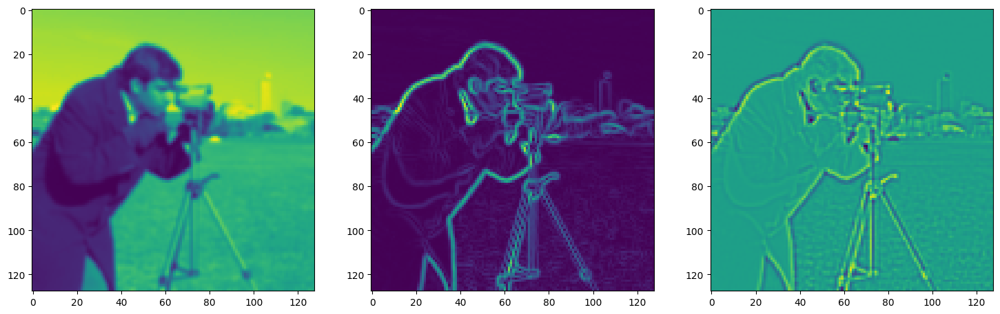

Step 450, Total loss 0.028909, iteration time 0.004088


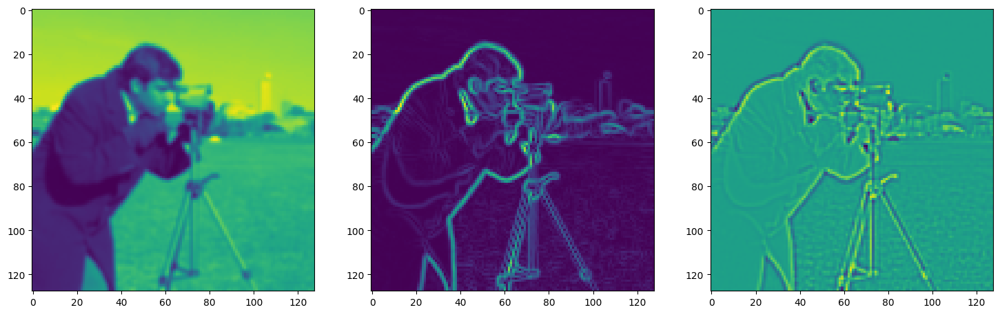

Step 460, Total loss 0.017388, iteration time 0.004034


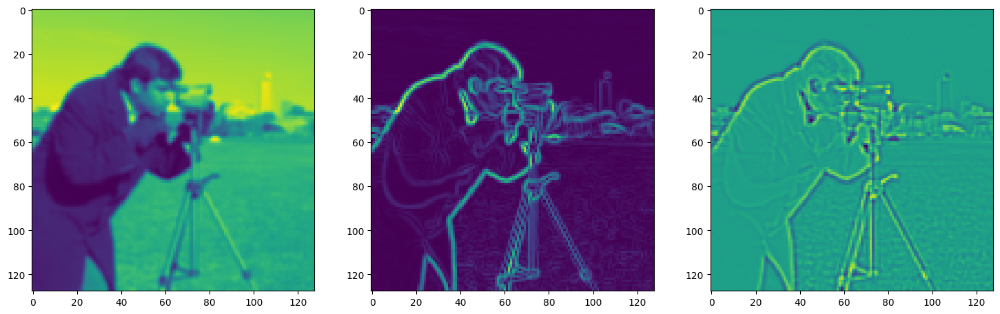

Step 470, Total loss 0.012795, iteration time 0.004086


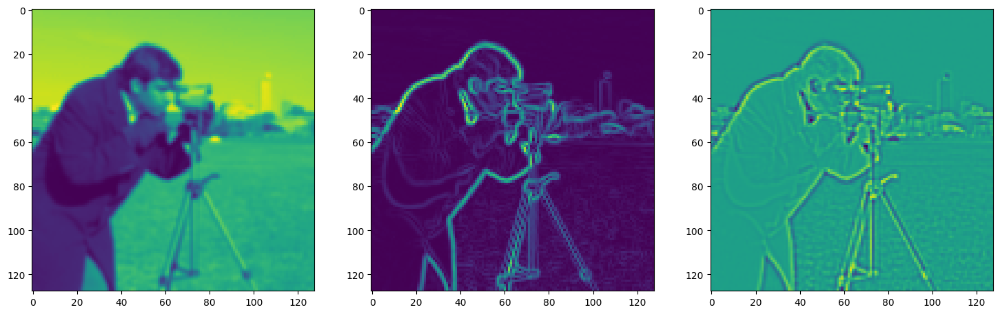

Step 480, Total loss 0.011929, iteration time 0.004238


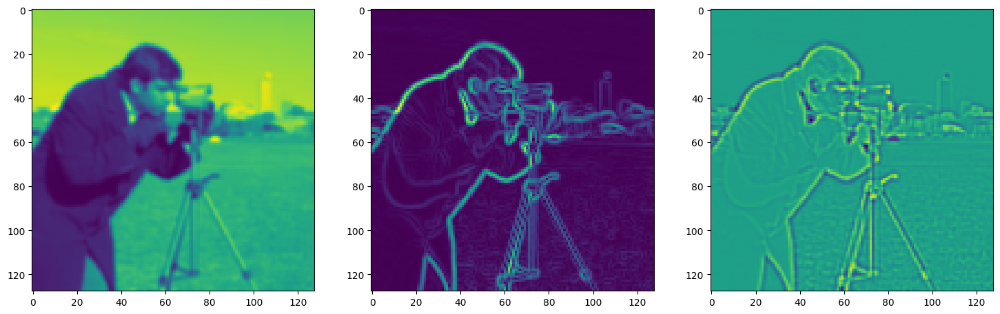

Step 490, Total loss 0.011327, iteration time 0.004043


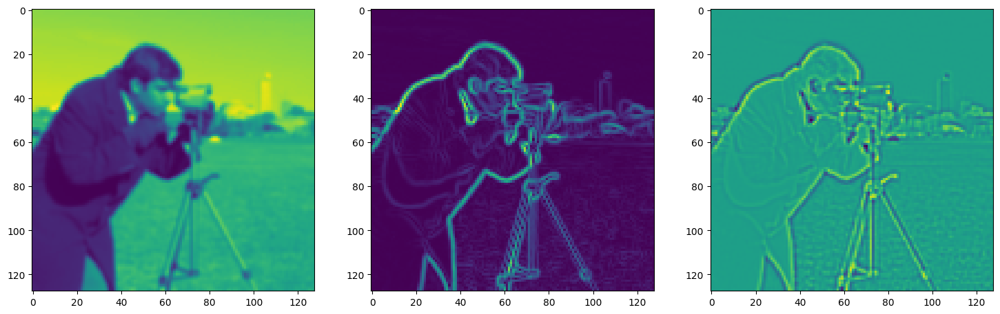

Step 500, Total loss 0.010998, iteration time 0.004040


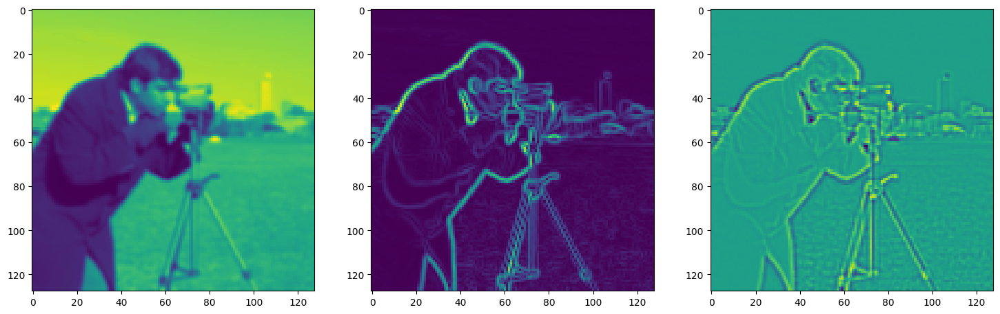

Step 510, Total loss 0.010759, iteration time 0.004250


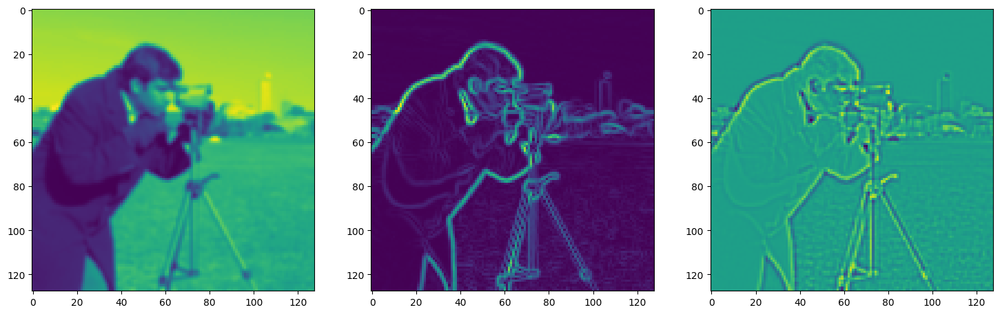

Step 520, Total loss 0.010565, iteration time 0.004011


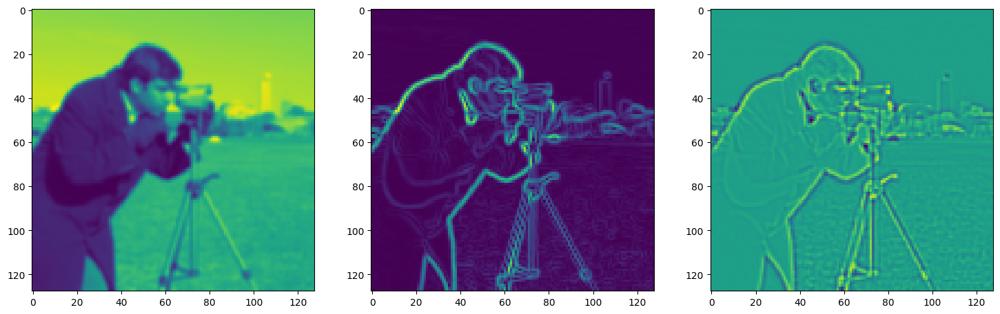

Step 530, Total loss 0.010390, iteration time 0.004007


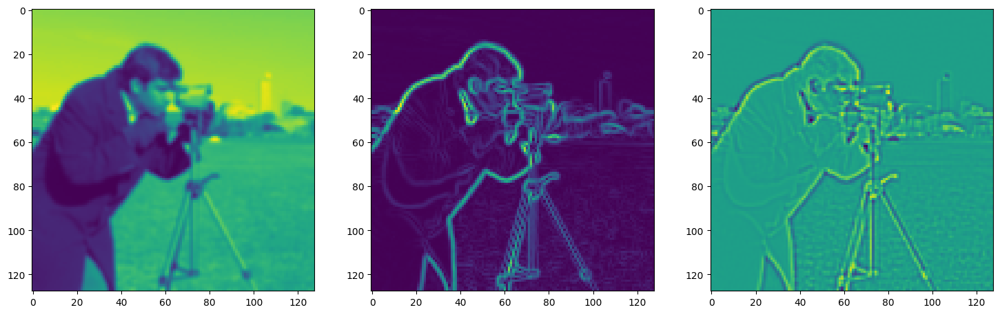

Step 540, Total loss 0.010499, iteration time 0.003954


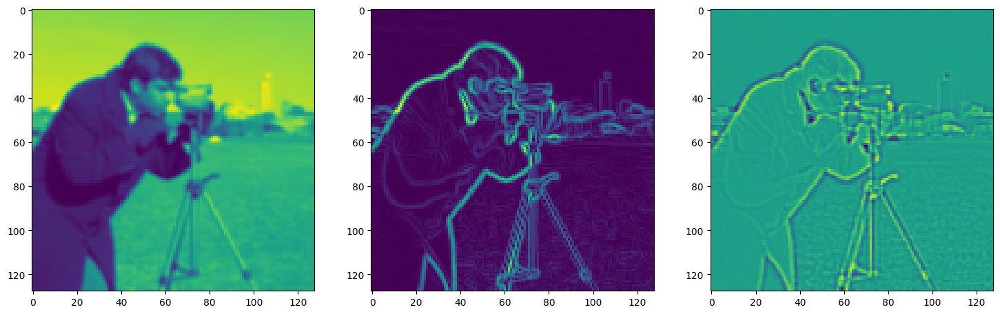

Step 550, Total loss 0.066500, iteration time 0.004144


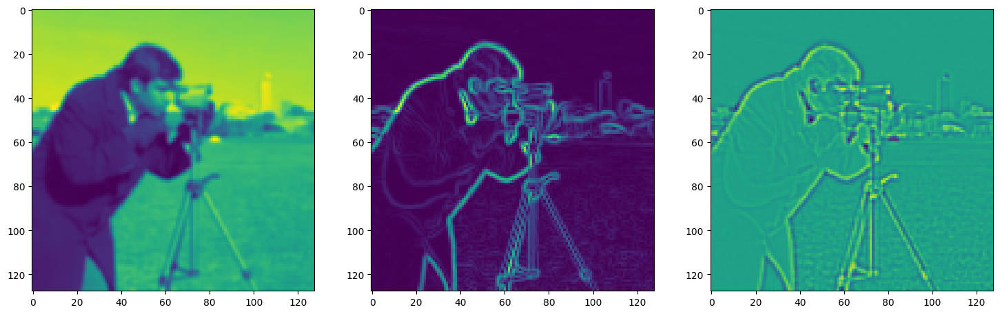

Step 560, Total loss 0.022292, iteration time 0.004122


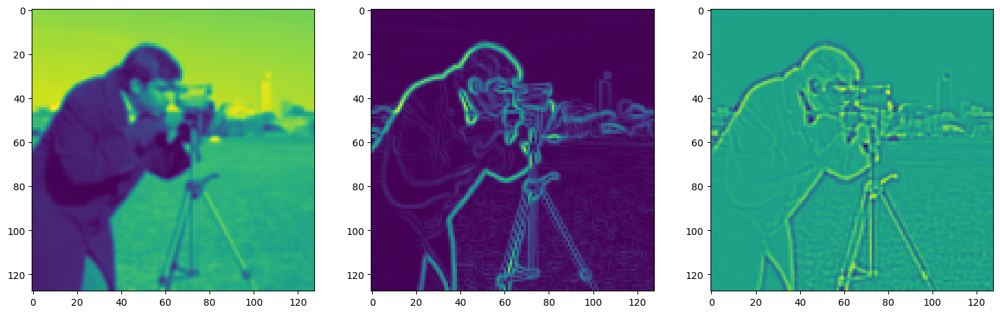

Step 570, Total loss 0.013547, iteration time 0.003985


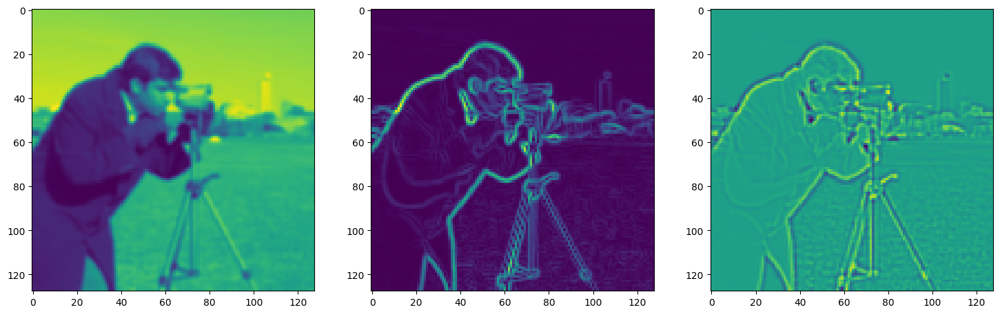

Step 580, Total loss 0.010764, iteration time 0.004005


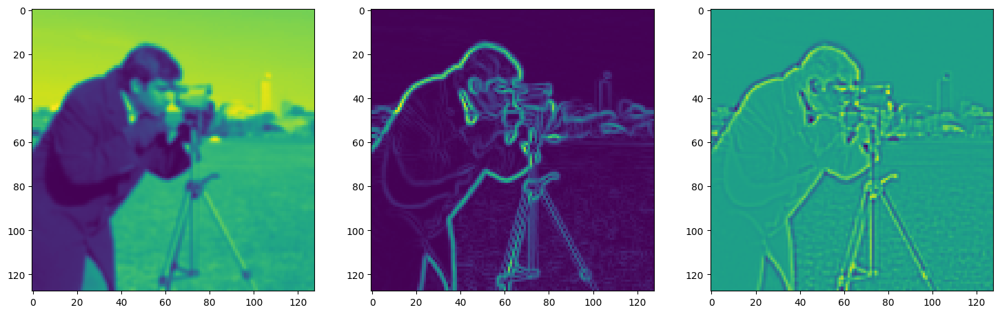

Step 590, Total loss 0.009736, iteration time 0.004053


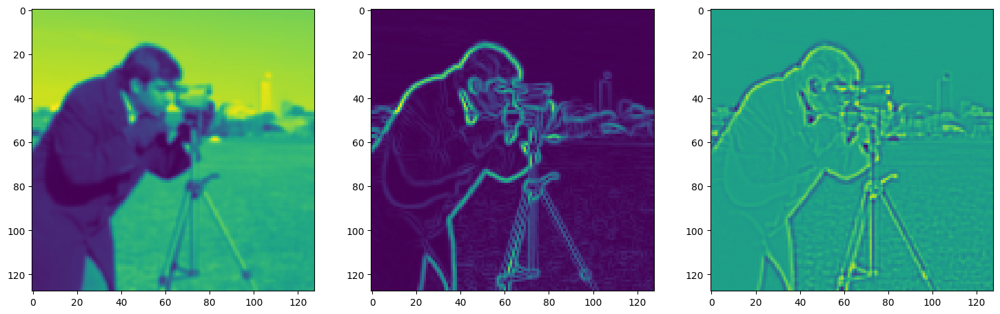

Step 600, Total loss 0.009404, iteration time 0.003982


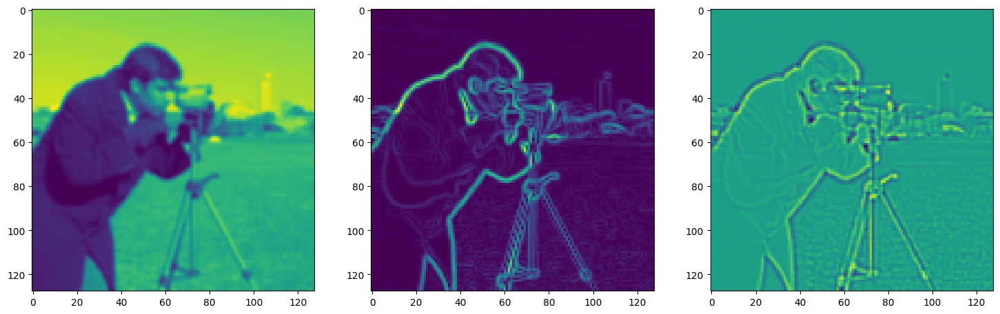

Step 610, Total loss 0.009165, iteration time 0.004080


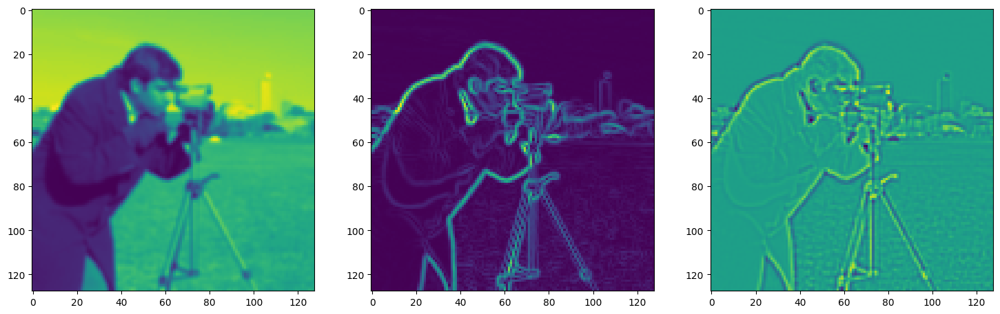

Step 620, Total loss 0.008982, iteration time 0.004115


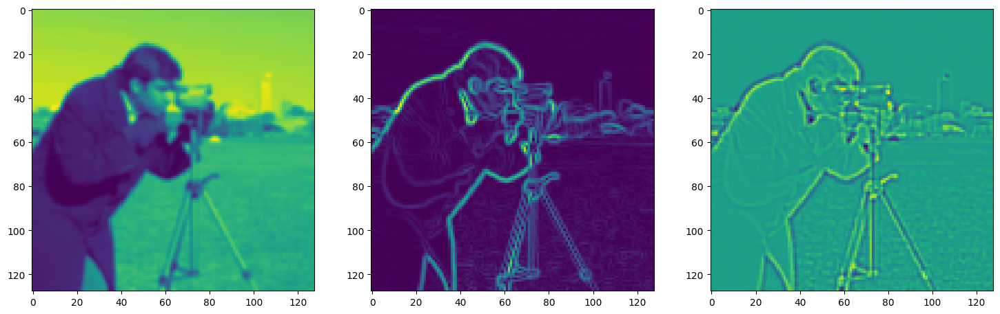

Step 630, Total loss 0.008822, iteration time 0.004044


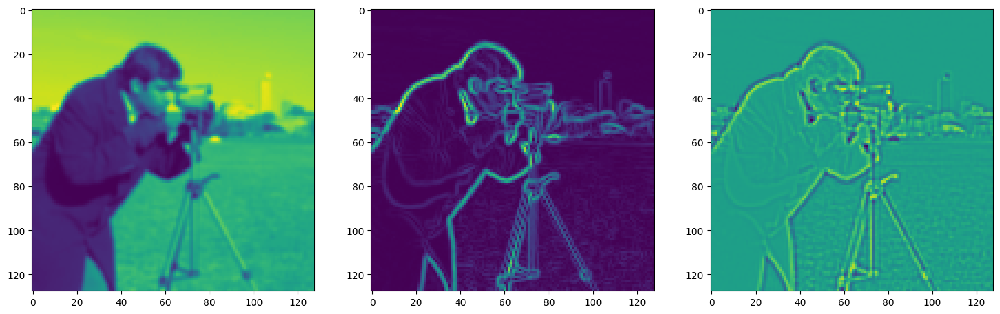

Step 640, Total loss 0.008676, iteration time 0.004175


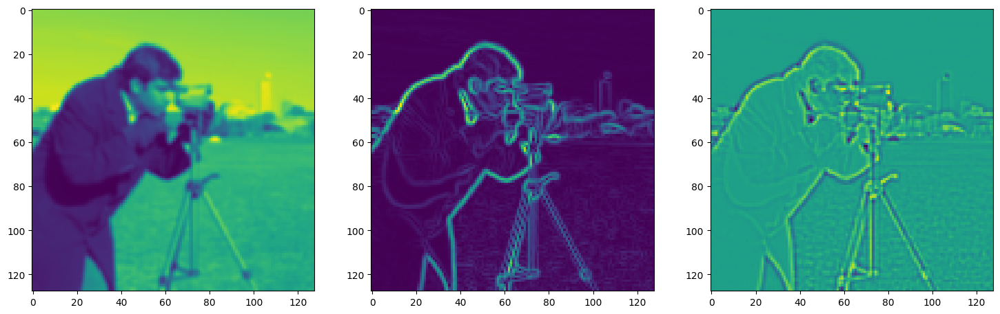

Step 650, Total loss 0.008534, iteration time 0.004062


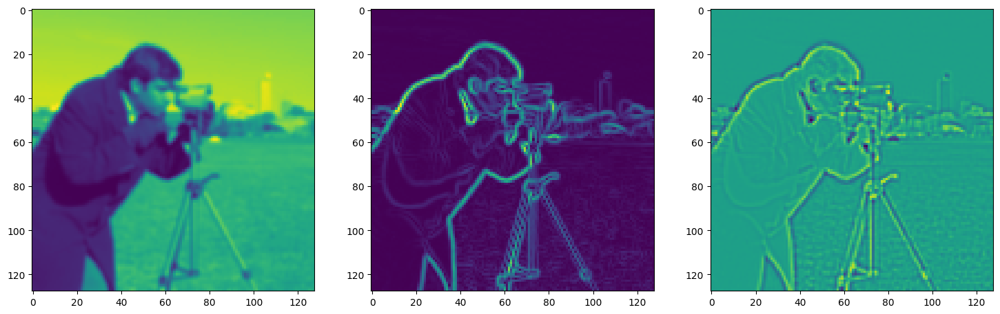

Step 660, Total loss 0.008398, iteration time 0.003970


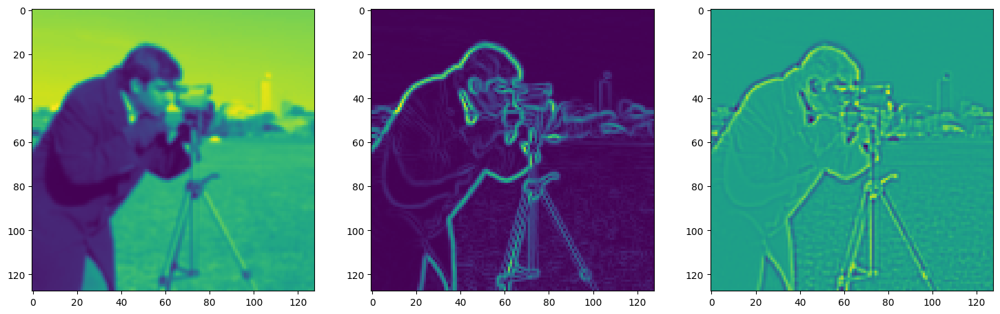

Step 670, Total loss 0.008696, iteration time 0.004090


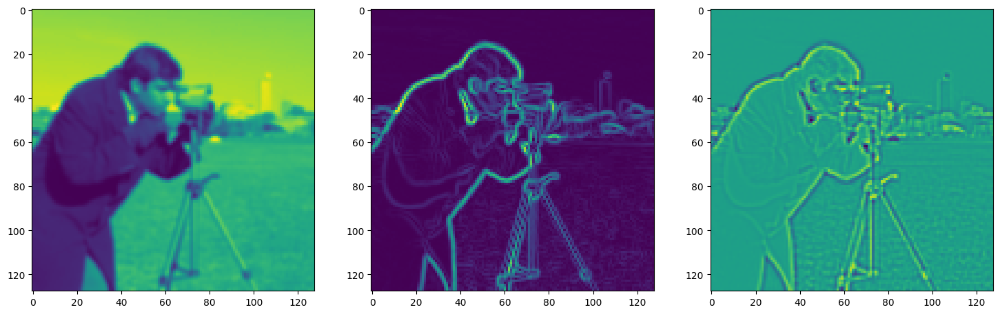

Step 680, Total loss 0.029792, iteration time 0.004130


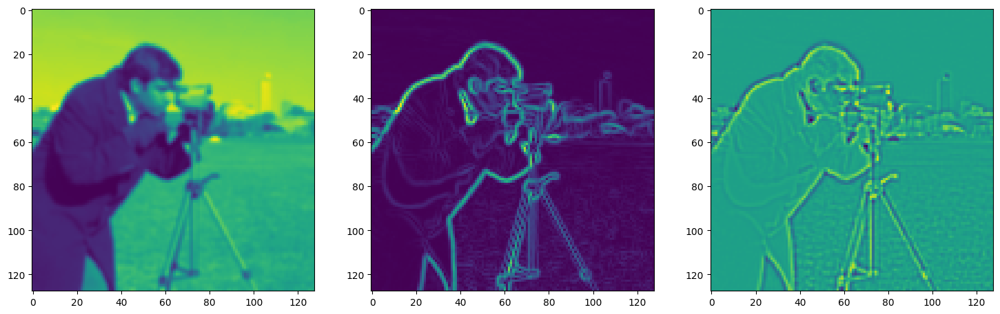

Step 690, Total loss 0.011084, iteration time 0.004043


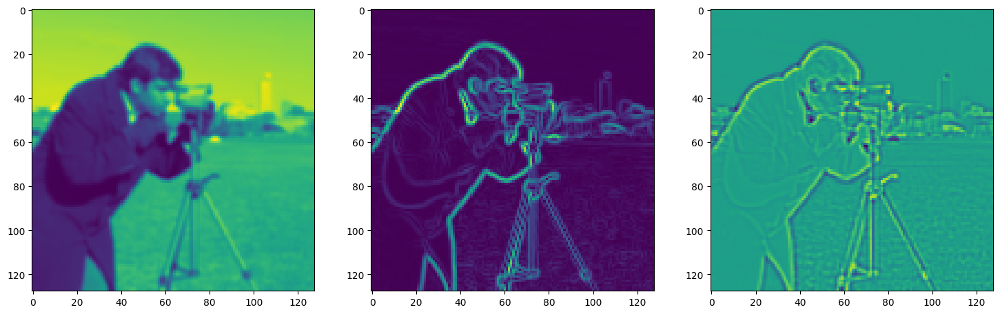

Step 700, Total loss 0.009559, iteration time 0.004159


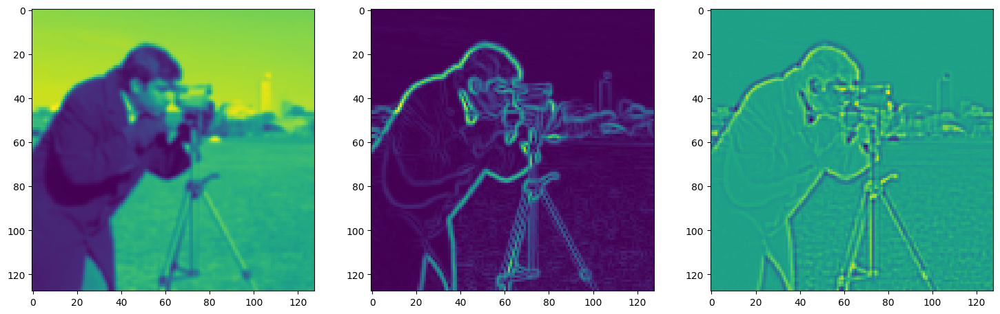

Step 710, Total loss 0.008310, iteration time 0.004173


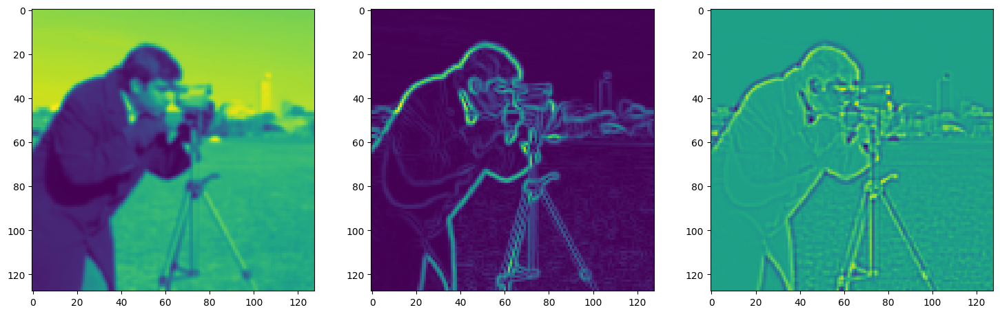

Step 720, Total loss 0.007881, iteration time 0.004045


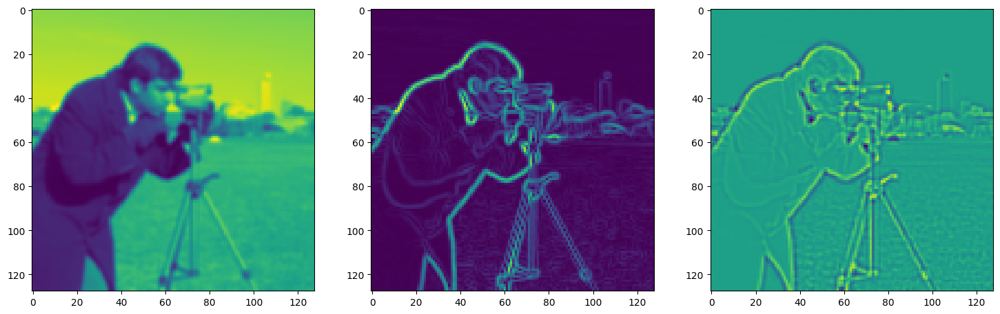

Step 730, Total loss 0.007611, iteration time 0.004040


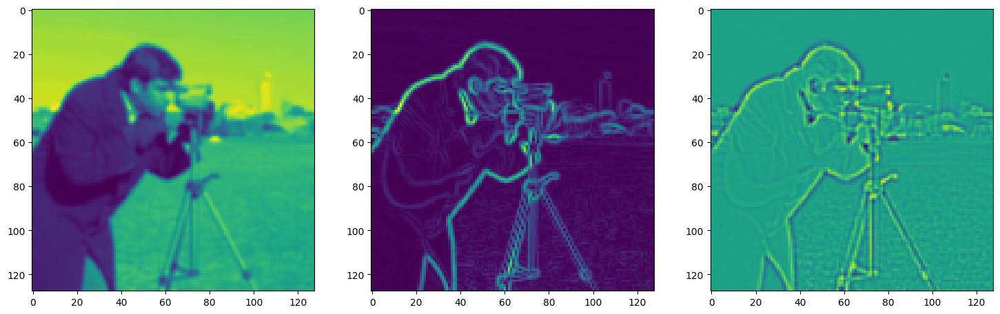

Step 740, Total loss 0.007472, iteration time 0.003980


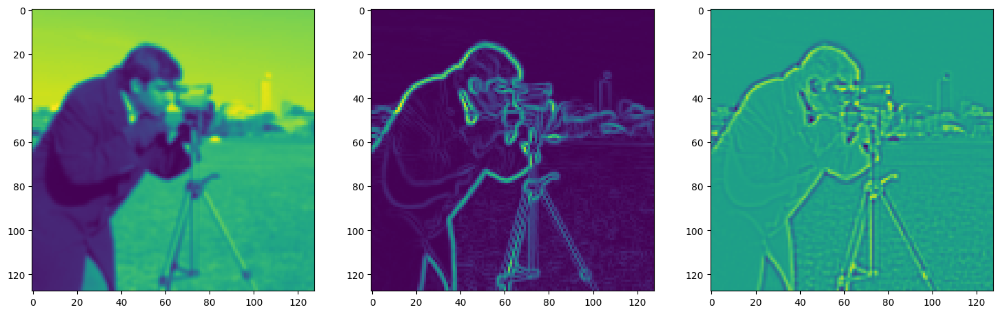

Step 750, Total loss 0.008211, iteration time 0.004076


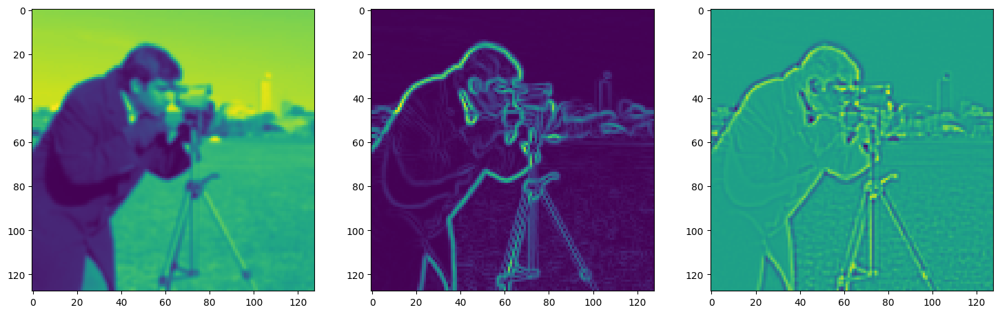

Step 760, Total loss 0.016508, iteration time 0.003951


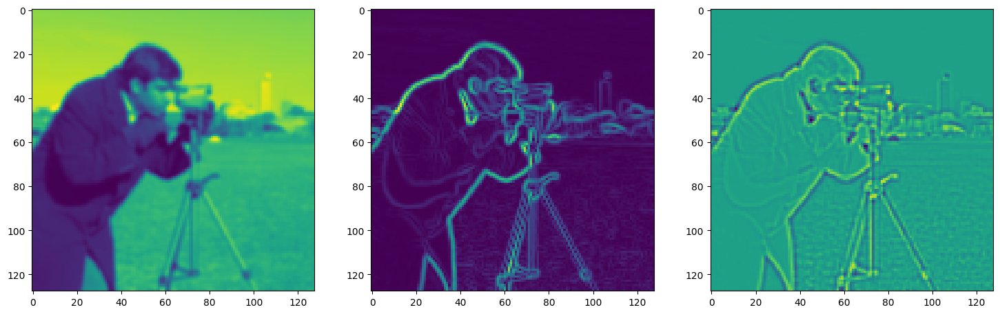

Step 770, Total loss 0.011781, iteration time 0.004105


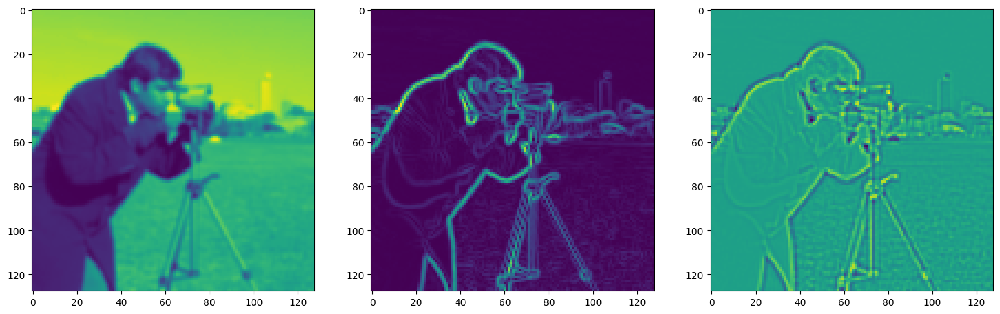

Step 780, Total loss 0.008463, iteration time 0.004020


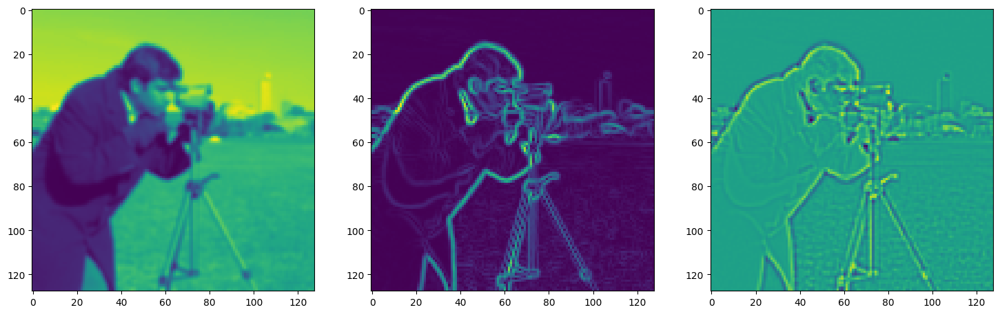

Step 790, Total loss 0.007355, iteration time 0.004041


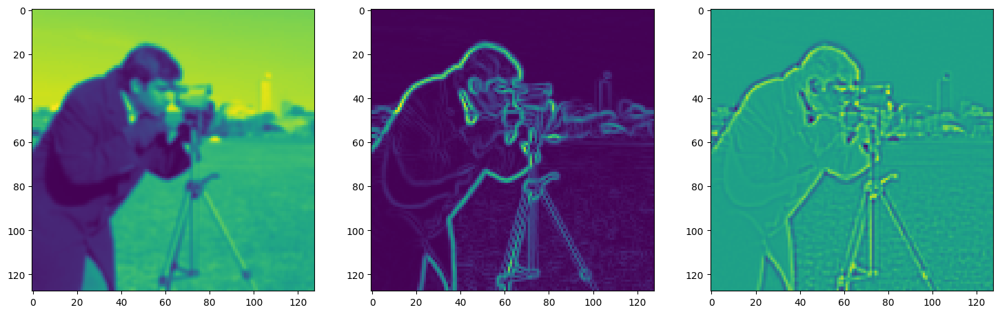

Step 800, Total loss 0.006993, iteration time 0.004099


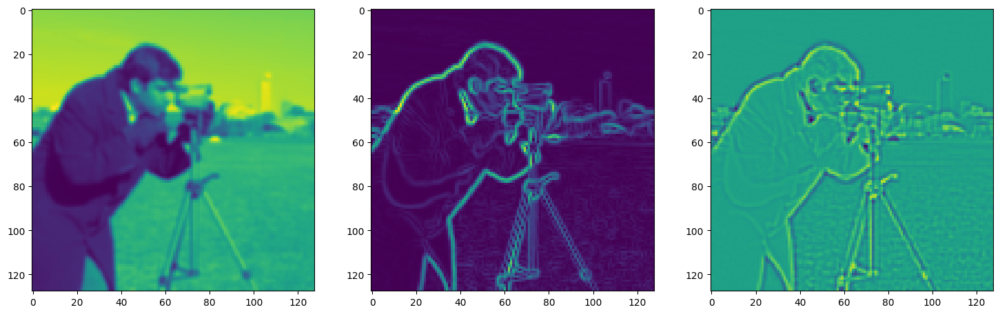

Step 810, Total loss 0.006802, iteration time 0.004074


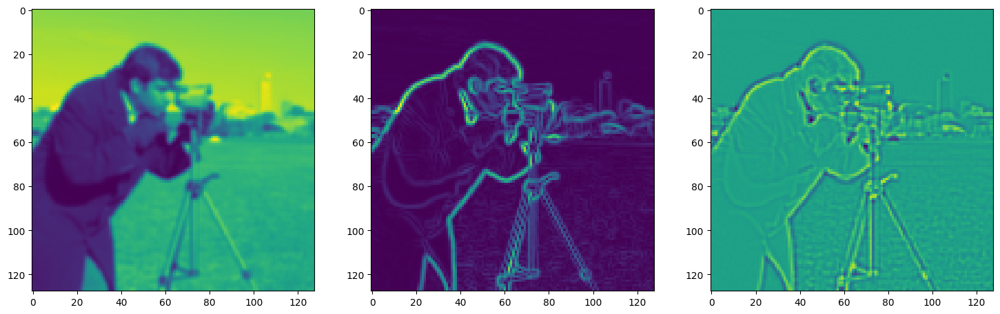

Step 820, Total loss 0.006617, iteration time 0.004024


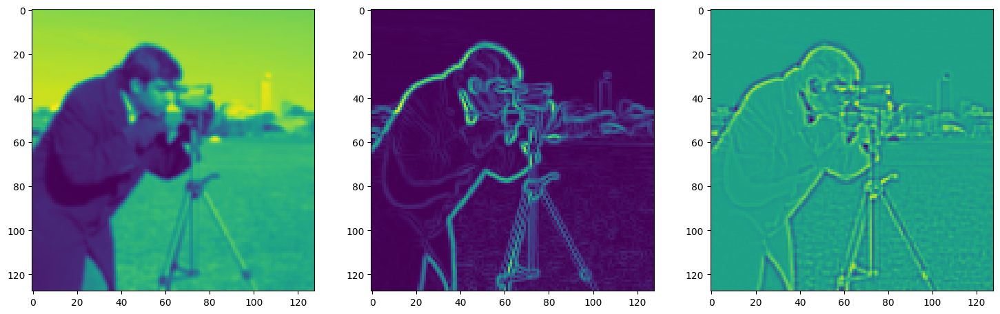

Step 830, Total loss 0.006838, iteration time 0.004038


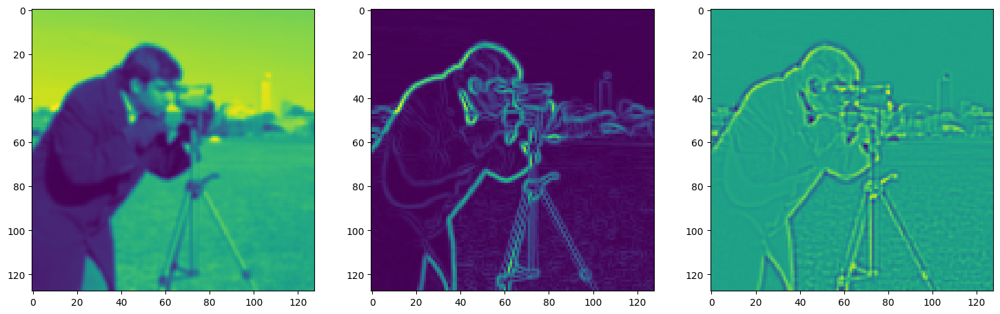

Step 840, Total loss 0.038143, iteration time 0.004132


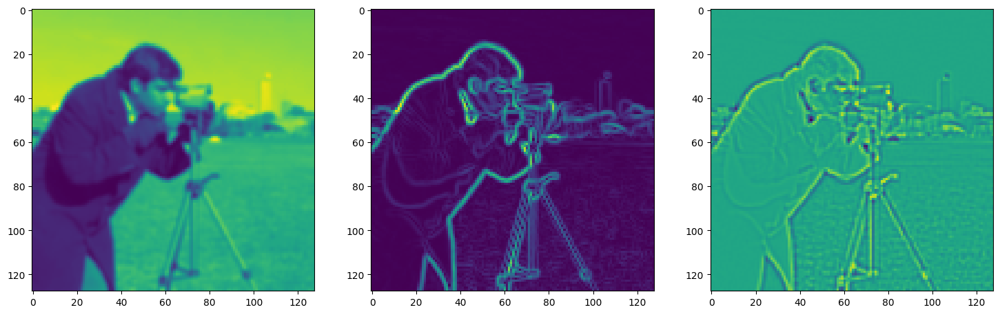

Step 850, Total loss 0.010418, iteration time 0.003995


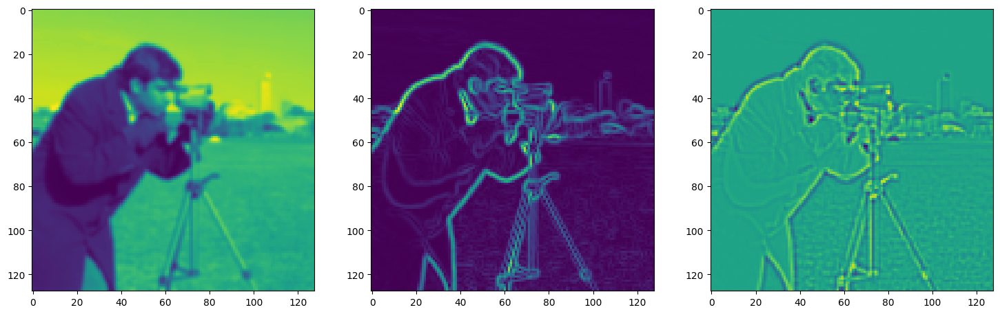

Step 860, Total loss 0.007715, iteration time 0.004124


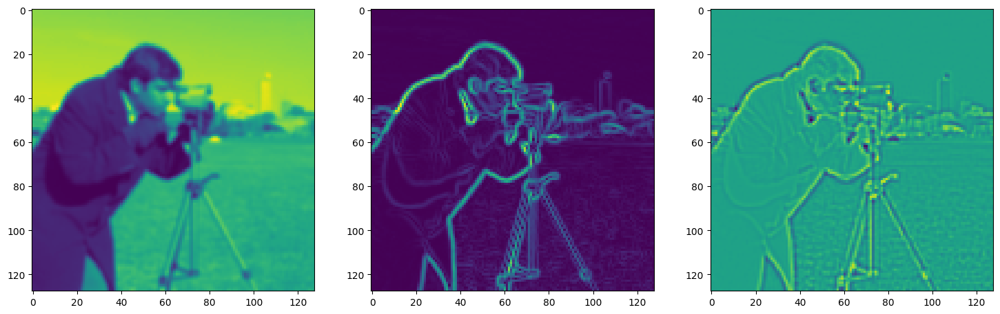

Step 870, Total loss 0.006617, iteration time 0.004294


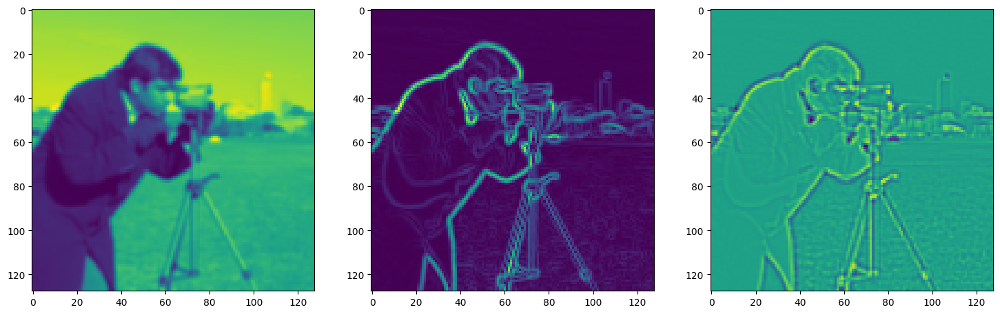

Step 880, Total loss 0.006248, iteration time 0.004023


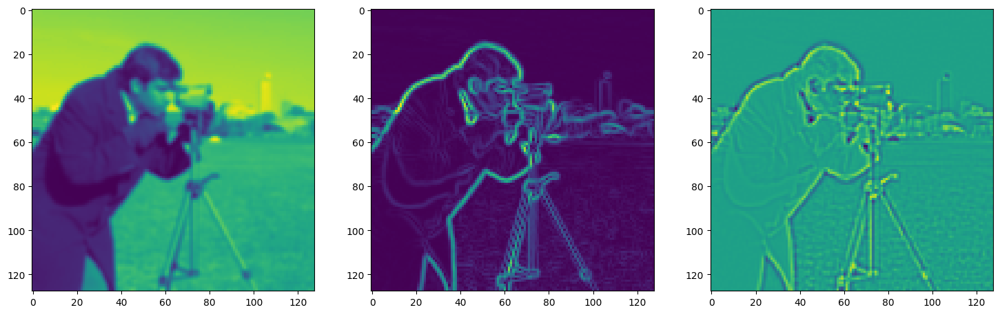

Step 890, Total loss 0.006095, iteration time 0.004161


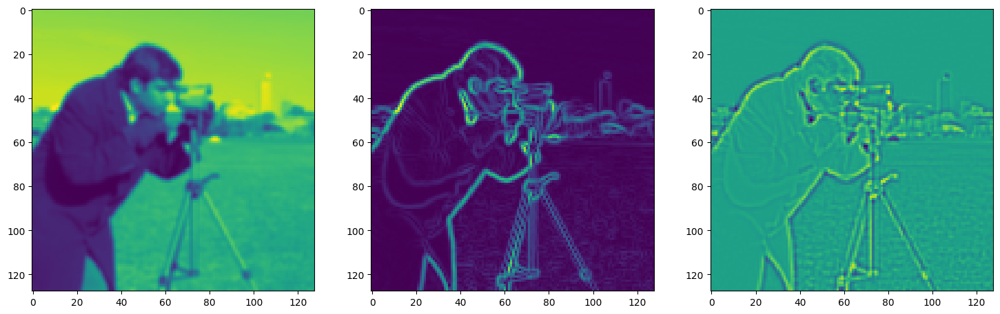

Step 900, Total loss 0.005959, iteration time 0.004031


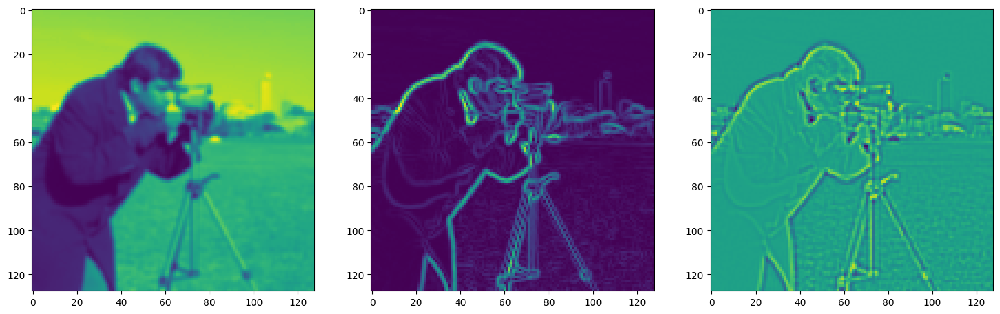

Step 910, Total loss 0.005863, iteration time 0.004229


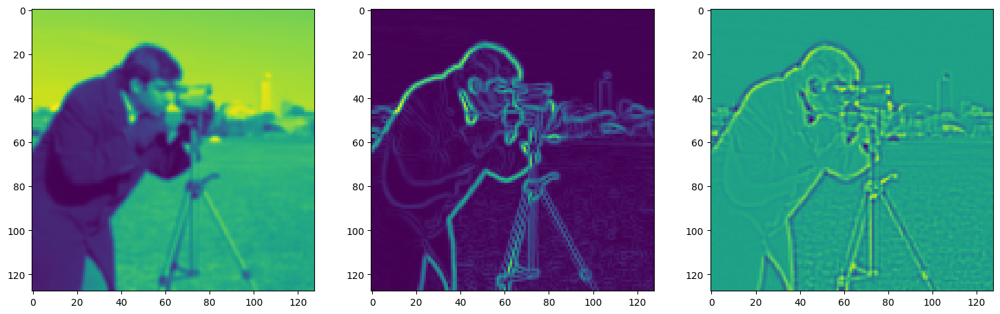

Step 920, Total loss 0.005898, iteration time 0.004041


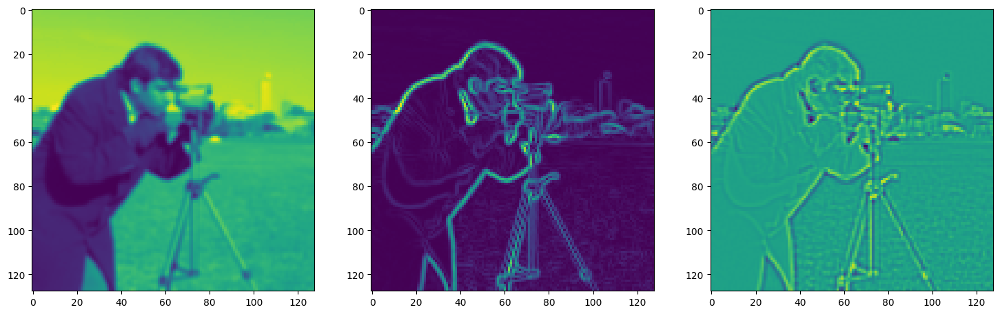

Step 930, Total loss 0.026399, iteration time 0.004095


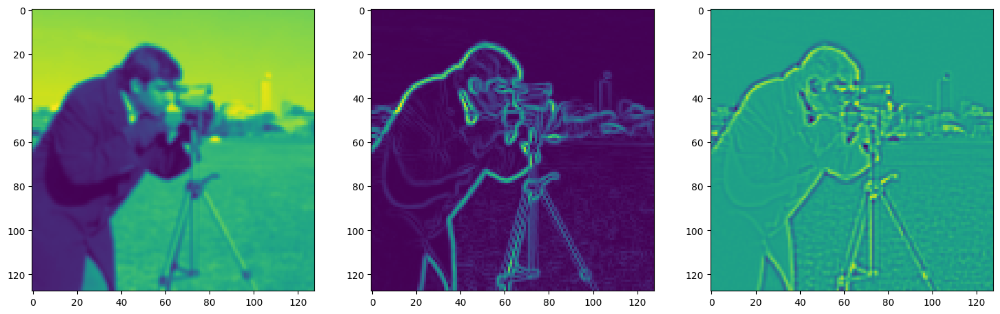

Step 940, Total loss 0.014903, iteration time 0.004055


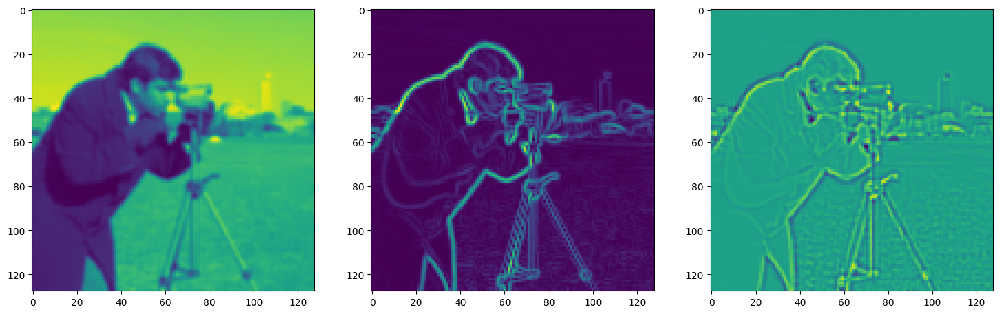

Step 950, Total loss 0.007884, iteration time 0.004046


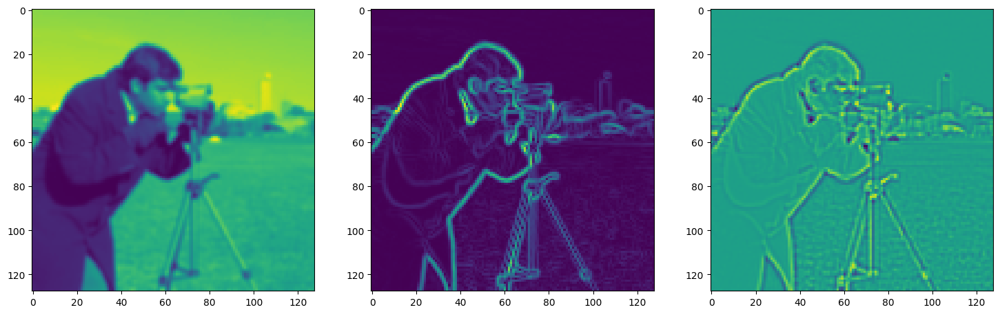

Step 960, Total loss 0.006316, iteration time 0.004151


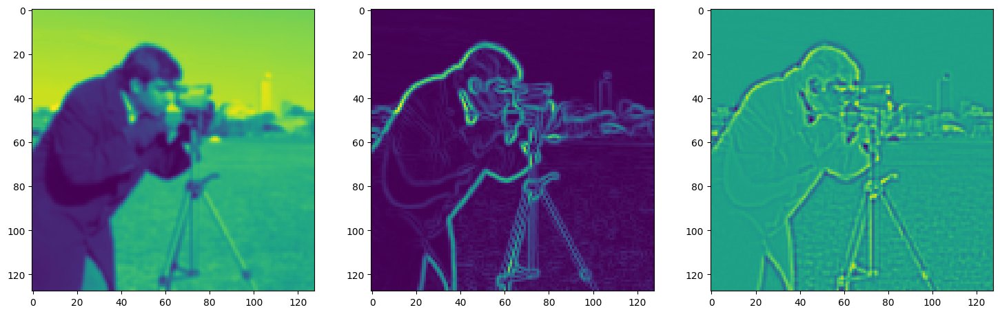

Step 970, Total loss 0.005673, iteration time 0.004119


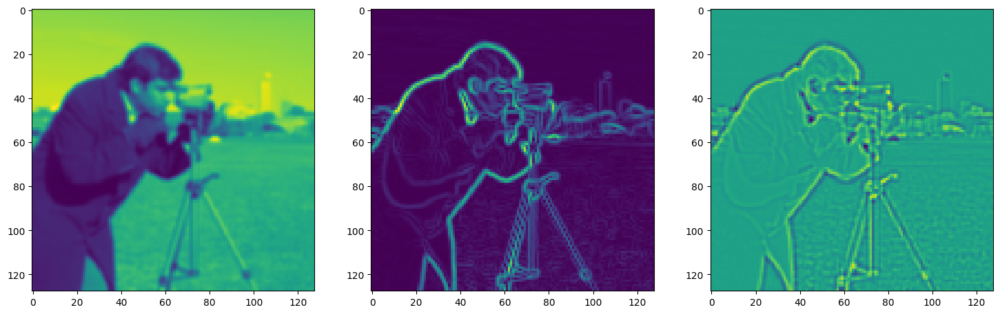

Step 980, Total loss 0.005433, iteration time 0.004025


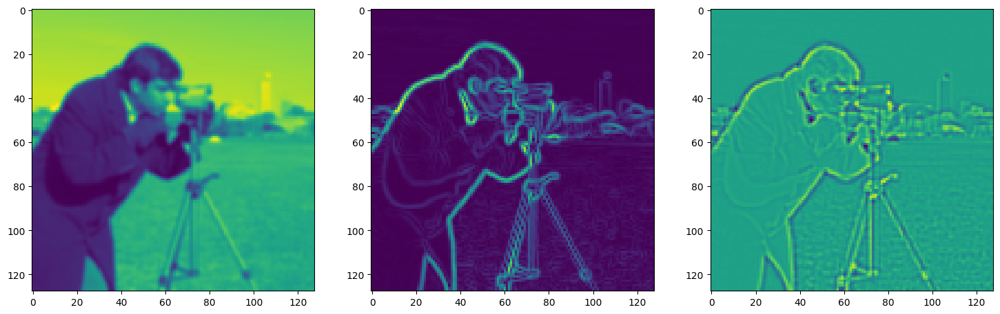

Step 990, Total loss 0.005312, iteration time 0.004107


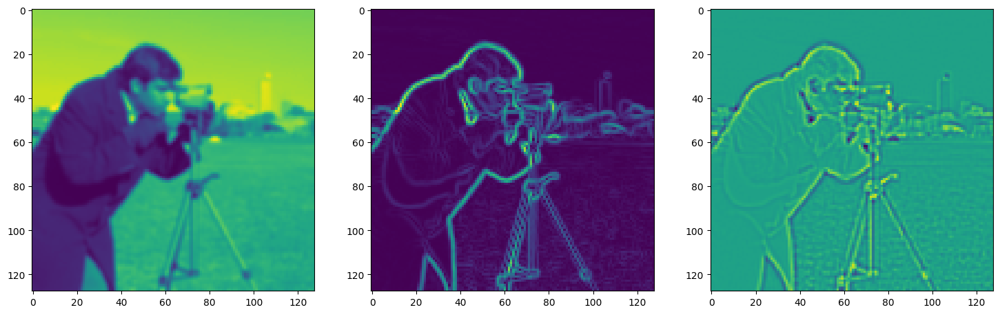

In [15]:
total_steps = 1000
steps_til_summary = 10

optim = torch.optim.Adam(lr=1e-4, params=poisson_siren.parameters())

model_input, gt = next(iter(dataloader))
gt = {key: value.to(device) for key, value in gt.items()}
model_input = model_input.to(device)

for step in range(total_steps):
    start_time = time.time()

    model_output, coords = poisson_siren(model_input)
    train_loss = gradients_mse(model_output, coords, gt['grads'])

    if not step % steps_til_summary:
        print("Step %d, Total loss %0.6f, iteration time %0.6f" % (step, train_loss, time.time() - start_time))

        img_grad = gradient(model_output, coords)
        img_laplacian = laplace(model_output, coords)

        fig, axes = plt.subplots(1, 3, figsize=(18, 6))
        axes[0].imshow(model_output.cpu().view(128,128).detach().numpy())
        axes[1].imshow(img_grad.cpu().norm(dim=-1).view(128,128).detach().numpy())
        axes[2].imshow(img_laplacian.cpu().view(128,128).detach().numpy())
        plt.show()
        
    optim.zero_grad()
    train_loss.backward()
    optim.step()

In [16]:
break

SyntaxError: 'break' outside loop (668683560.py, line 4)

<a id='activations'></a>
## Initialization scheme & distribution of activations

We now reproduce the empirical result on the distribution of activations, and will thereafter show empirically that the distribution of activations is shift-invariant as well! 

In [ ]:
from collections import OrderedDict
import matplotlib
import numpy.fft as fft
import scipy.stats as stats


def eformat(f, prec, exp_digits):
    s = "%.*e"%(prec, f)
    mantissa, exp = s.split('e')
    # add 1 to digits as 1 is taken by sign +/-
    return "%se%+0*d"%(mantissa, exp_digits+1, int(exp))

def format_x_ticks(x, pos):
    """Format odd tick positions
    """
    return eformat(x, 0, 1)

def format_y_ticks(x, pos):
    """Format odd tick positions
    """
    return eformat(x, 0, 1)

def get_spectrum(activations):
    n = activations.shape[0]

    spectrum = fft.fft(activations.numpy().astype(np.double).sum(axis=-1), axis=0)[:n//2]
    spectrum = np.abs(spectrum)

    max_freq = 100                
    freq = fft.fftfreq(n, 2./n)[:n//2]
    return freq[:max_freq], spectrum[:max_freq]


def plot_all_activations_and_grads(activations):
    num_cols = 4
    num_rows = len(activations)
    
    fig_width = 5.5
    fig_height = num_rows/num_cols*fig_width
    fig_height = 9
    
    fontsize = 5
        
    fig, axs = plt.subplots(num_rows, num_cols, gridspec_kw={'hspace': 0.3, 'wspace': 0.2},
                            figsize=(fig_width, fig_height), dpi=300)
    
    axs[0][0].set_title("Activation Distribution", fontsize=7, fontfamily='serif', pad=5.)
    axs[0][1].set_title("Activation Spectrum", fontsize=7, fontfamily='serif', pad=5.)
    axs[0][2].set_title("Gradient Distribution", fontsize=7, fontfamily='serif', pad=5.)
    axs[0][3].set_title("Gradient Spectrum", fontsize=7, fontfamily='serif', pad=5.)

    x_formatter = matplotlib.ticker.FuncFormatter(format_x_ticks)
    y_formatter = matplotlib.ticker.FuncFormatter(format_y_ticks)

    spec_rows = []
    for idx, (key, value) in enumerate(activations.items()):    
        grad_value = value.grad.cpu().detach().squeeze(0)
        flat_grad = grad_value.view(-1)
        axs[idx][2].hist(flat_grad, bins=256, density=True)
        
        value = value.cpu().detach().squeeze(0) # (1, num_points, 256)
        n = value.shape[0]
        flat_value = value.view(-1)
            
        axs[idx][0].hist(flat_value, bins=256, density=True)
                
        if idx>1:
            if not (idx)%2:
                x = np.linspace(-1, 1., 500)
                axs[idx][0].plot(x, stats.arcsine.pdf(x, -1, 2), 
                                 linestyle=':', markersize=0.4, zorder=2)
            else:
                mu = 0
                variance = 1
                sigma = np.sqrt(variance)
                x = np.linspace(mu - 3*sigma, mu + 3*sigma, 500)
                axs[idx][0].plot(x, stats.norm.pdf(x, mu, sigma), 
                                 linestyle=':', markersize=0.4, zorder=2)
        
        activ_freq, activ_spec = get_spectrum(value)
        axs[idx][1].plot(activ_freq, activ_spec)
        
        grad_freq, grad_spec = get_spectrum(grad_value)
        axs[idx][-1].plot(grad_freq, grad_spec)
        
        for ax in axs[idx]:
            ax.tick_params(axis='both', which='major', direction='in',
                                    labelsize=fontsize, pad=1., zorder=10) 
            ax.tick_params(axis='x', labelrotation=0, pad=1.5, zorder=10) 

            ax.xaxis.set_major_formatter(x_formatter)
            ax.yaxis.set_major_formatter(y_formatter)

In [ ]:
input_signal.shape

In [ ]:
import lovely_tensors as lt
lt.monkey_patch()

In [ ]:
for key, value in activations.items():
    print(key)
    display(value.plt)
    display(value.grad.plt)    

In [ ]:
activations

In [ ]:
model = Siren(in_features=1, hidden_features=2048, 
              hidden_layers=10, out_features=1, outermost_linear=True)

input_signal = torch.linspace(-1, 1, 65536//4).view(1, 65536//4, 1)
activations = model.forward_with_activations(input_signal, retain_grad=True)
output = activations[next(reversed(activations))]

# Compute gradients. Because we have retain_grad=True on 
# activations, each activation stores its own gradient!
output.mean().backward()

plot_all_activations_and_grads(activations)

Note how the activations of Siren always alternate between a standard normal distribution with standard deviation one, and an arcsine distribution. If you have a beefy computer, you can put this to the extreme and increase the number of layers - this property holds even for more than 50 layers!

<a id='shift_invariance'></a>
## Distribution of activations is shift-invariant

One of the key properties of the periodic sine nonlinearity is that it affords a degree of shift-invariance. Consider the first layer of a Siren: You can convince yourself that this layer can easily learn to map two different coordinates to *the same set of activations*. This means that whatever layers come afterwards will apply the same function to these two sets of coordinates.

Moreoever, the distribution of activations similarly are shift-invariant. Let's shift our input signal by 1000 and re-compute the activations:

In [ ]:
input_signal = torch.linspace(-1, 1, 65536//4).view(1, 65536//4, 1) + 1000
activations = model.forward_with_activations(input_signal, retain_grad=True)
output = activations[next(reversed(activations))]

# Compute gradients. Because we have retain_grad=True on 
# activations, each activation stores its own gradient!
output.mean().backward()

plot_all_activations_and_grads(activations)

As we can see, the distributions of activations didn't change at all - they are perfectly invariant to the shift.